In [ ]:
# from google.colab import drive
# drive.mount('/content/drive/')

In [ ]:
# !python -m pip install torchinfo

In [ ]:
%run ./Utils.ipynb

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import torchvision
import torchinfo
from torchvision import models
import torch.nn.init as init
import torch.optim as optim
import warnings
import torch.optim.lr_scheduler as lr_scheduler
warnings.filterwarnings("ignore")

In [ ]:
batch_size = 16
val_batch_size = 5
device = 'cuda:0'

In [ ]:
train_dataset = FinalDataset(X_path="../data/L_256.pt", y_path="../data/AB_256.pt")
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=1)

In [ ]:
val_dataset = FinalDataset(X_path="../data/val_L_256.pt", y_path="../data/val_AB_256.pt")
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=val_batch_size, num_workers=1)

In [ ]:
class UNet(nn.Module):
  def __init__(self, block):
    super(UNet, self).__init__()
    self.conv1_batchnorm = nn.BatchNorm2d(16)
    self.conv1 = nn.Conv2d(1, 16, 3, padding=1)
    self.pool = nn.MaxPool2d(2, 2)                                               # Will halve the dim and twice the depth
    self.enAct = nn.ReLU()
    self.act = nn.LeakyReLU(0.3)
    self.out = nn.Tanh()
    self.en_layer_1 = residual_layer(block, 1, 16, 0.1)
    self.en_layer_2 = residual_layer(block, 1, 32, 0.1)
    self.en_layer_3 = residual_layer(block, 1, 64, 0.1)
    self.en_layer_4 = residual_layer(block, 1, 128, 0.1)
    self.en_layer_5 = residual_layer(block, 1, 256, 0.1)
    self.de_upConv_1 = nn.ConvTranspose2d(512, 256, 2, 2)                        # Will upsample the output of last layer
    self.de_batchnorm_1 = nn.BatchNorm2d(256)
    self.de_conv_1_1 = nn.Conv2d(512, 256, 3, padding=1)                         # the decoder conv layer, this will reduce the filter size at each itr
    self.de_batchnorm_1_1 = nn.BatchNorm2d(256)
    self.de_conv_1_2 = nn.Conv2d(256, 256, 3, padding=1)
    self.de_batchnorm_1_2 = nn.BatchNorm2d(256)
    self.de_upConv_2 = nn.ConvTranspose2d(256, 128, 2, 2)
    self.de_batchnorm_2 = nn.BatchNorm2d(128)
    self.de_conv_2_1 = nn.Conv2d(256, 128, 3, padding=1)
    self.de_batchnorm_2_1 = nn.BatchNorm2d(128)
    self.de_conv_2_2 = nn.Conv2d(128, 128, 3, padding=1)
    self.de_batchnorm_2_2 = nn.BatchNorm2d(128)
    self.de_upConv_3 = nn.ConvTranspose2d(128, 64, 2, 2)
    self.de_batchnorm_3 = nn.BatchNorm2d(64)
    self.de_conv_3_1 = nn.Conv2d(128, 64, 3, padding=1)
    self.de_batchnorm_3_1 = nn.BatchNorm2d(64)
    self.de_conv_3_2 = nn.Conv2d(64, 64, 3, padding=1)
    self.de_batchnorm_3_2 = nn.BatchNorm2d(64)
    self.de_upConv_4 = nn.ConvTranspose2d(64, 32, 2, 2)
    self.de_batchnorm_4 = nn.BatchNorm2d(32)
    self.de_conv_4_1 = nn.Conv2d(64, 32, 3, padding=1)
    self.de_batchnorm_4_1 = nn.BatchNorm2d(32)
    self.de_conv_4_2 = nn.Conv2d(32, 32, 3, padding=1)
    self.de_batchnorm_4_2 = nn.BatchNorm2d(32)

    self.output_conv = nn.Conv2d(32, 2, 3, padding=1)
    self.out_batchnorm = nn.LayerNorm([2, 256, 256])

  def forward(self, x):
    x = self.enAct(self.conv1(x))
    x = self.conv1_batchnorm(x)
    en_1 = self.en_layer_1(x)                                                    # Resnet block will output same dim images with double depth each turn; will pool after each resnet layer for dim/2
    x = self.pool(en_1)
    en_2 = self.en_layer_2(x)                                                    # These outputs will be concated with decoder layer, for better result as suggested in the paper
    x = self.pool(en_2)
    en_3 = self.en_layer_3(x)
    x = self.pool(en_3)
    en_4 = self.en_layer_4(x)
    x = self.pool(en_4)
    en_5 = self.en_layer_5(x)
    up_1 = self.de_upConv_1(en_5)                                                # The kernel and strides are chosen such that dim of feature doubles but we halve the depth
    up_1 = self.de_batchnorm_1(up_1)
    x = torch.cat([en_4, up_1], dim= 1)                                          # After concat with same depth size encoder layer, we will get same depth feature vector which the decoder convs will reduce
    x = self.act(self.de_conv_1_1(x))
    x = self.de_batchnorm_1_1(x)
    x = self.act(self.de_conv_1_2(x))
    x = self.de_batchnorm_1_2(x)
    up_2 = self.de_upConv_2(x)
    up_2 = self.de_batchnorm_2(up_2)
    x = torch.cat([en_3, up_2], dim= 1)
    x = self.act(self.de_conv_2_1(x))
    x = self.de_batchnorm_2_1(x)
    x = self.act(self.de_conv_2_2(x))
    x = self.de_batchnorm_2_2(x)
    up_3 = self.de_upConv_3(en_3)
    up_3 = self.de_batchnorm_3(up_3)
    x = torch.cat([en_2, up_3], dim= 1)
    x = self.act(self.de_conv_3_1(x))
    x = self.de_batchnorm_3_1(x)
    x = self.act(self.de_conv_3_2(x))
    x = self.de_batchnorm_3_2(x)
    up_4 = self.de_upConv_4(x)
    up_4 = self.de_batchnorm_4(up_4)
    x = torch.cat([en_1, up_4], dim= 1)
    x = self.act(self.de_conv_4_1(x))
    x = self.de_batchnorm_4_1(x)
    x = self.act(self.de_conv_4_2(x))
    x = self.de_batchnorm_4_2(x)

    x = self.output_conv(x)
    x = self.out_batchnorm(x)

    return self.out(x)

  def init_weights(self, model):
    classname = model.__class__.__name__
    if hasattr(model, 'weight') and 'Conv' in classname:
        nn.init.xavier_normal_(m.weight.data, gain=0.2)
    elif 'BatchNorm2d' in classname:
            nn.init.xavier_normal_(m.weight.data, 1., 0.2)
            nn.init.constant_(m.bias.data, 0.)

In [ ]:
model = UNet(ResidualBlock)
# model.load_state_dict(torch.load("./ResnetBackbone_UNet_Full/UNet_1450.pth"))
# loss_list = torch.load('./ResnetBackbone_UNet_Full/training_loss.pth')
# val_loss_list = torch.load('./ResnetBackbone_UNet_Full/validation_loss.pth')
# model.init_weights(model)
# optimiser = optim.SGD(model.parameters(), lr=2e-1, momentum=0.9)
optimiser = optim.Adam(model.parameters(), lr=2e-4, betas=(0.5, 0.999))
optimiser_500 = optim.Adam(model.parameters(), lr=2e-6, betas=(0.5, 0.999))
scheduler = lr_scheduler.StepLR(optimiser, step_size=20, gamma=0.1)
model.to(device)
loss_list = []
val_loss_list = []

def train_model(num_epochs, model):
  l1_loss = nn.L1Loss()
  model.train()
  for epoch in range(num_epochs):
    epoch_loss = 0
    # epoch += 1785
    for batch_idx, (X, y) in enumerate(train_loader):
        X = X.to(device)
        y = y.to(device)

        # prediction from both models
        if(epoch < 1000):
            optimiser.zero_grad()
        else:
            optimiser_500.zero_grad()
        pred = model(X)

        # Calculating loss for each net
        loss = l1_loss(pred, y)

        # Loss backwards and calling the optimiser
        loss.backward()

        epoch_loss += loss.item()

        if(epoch < 500):
            optimiser.step()
        else:
            optimiser_500.step()

        # if(epoch < 40):
        #     scheduler.step()

        if batch_idx % 10 == 0:
            print('Train Epoch: {} [{}/{} ({:.0f}%)]\tUNetLoss: {:.6f}'.format(
              epoch, batch_idx * len(X), len(train_loader.dataset),
              100. * batch_idx / len(train_loader), loss.item()))

    loss_list.append(epoch_loss)
    val_loss_list.append(val_model(model, False))
    if epoch %50 == 0:
        print("Training Output: ")
        imshow(X, y)
        imshow(X, model(X))
        print("validation Output: ")
        val_model(model, True)
    if epoch % 50 == 0:
      saveModel(model, './ResnetBackbone_UNet_Full/UNet_' + str(epoch) + '.pth')
      torch.save(loss_list, './ResnetBackbone_UNet_Full/training_loss.pth')
      torch.save(val_loss_list, './ResnetBackbone_UNet_Full/validation_loss.pth')

  return (loss_list, val_loss_list)

In [ ]:
def val_model(model, showImages):
  avg_loss = 0
  l1_mae = nn.L1Loss()
  batch_count = 0
  for (X, y) in val_loader:
    X = X.to(device)
    y = y.to(device)

    pred = model(X)

    avg_loss += l1_mae(pred, y).item()

    if(showImages):
        imshow(X, y)
        imshow(X, model(X))
        batch_count = 1
        break;
    batch_count+= 1;

  return avg_loss / batch_count

Train Epoch: 0 [0/256 (0%)]	UNetLoss: 0.511922
Train Epoch: 0 [160/256 (62%)]	UNetLoss: 0.295814
Training Output: 


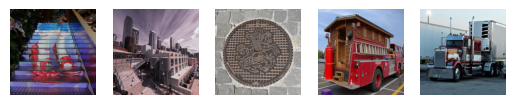

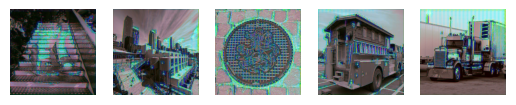

validation Output: 


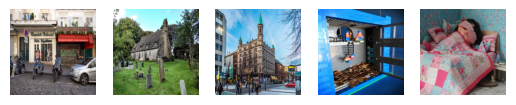

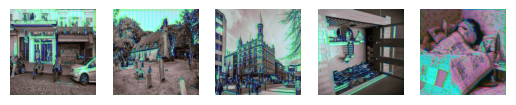


Saved model to ./ResnetBackbone_UNet_Full/UNet_0.pth.
Train Epoch: 1 [0/256 (0%)]	UNetLoss: 0.228775
Train Epoch: 1 [160/256 (62%)]	UNetLoss: 0.178598
Train Epoch: 2 [0/256 (0%)]	UNetLoss: 0.185204
Train Epoch: 2 [160/256 (62%)]	UNetLoss: 0.139116
Train Epoch: 3 [0/256 (0%)]	UNetLoss: 0.137059
Train Epoch: 3 [160/256 (62%)]	UNetLoss: 0.133137
Train Epoch: 4 [0/256 (0%)]	UNetLoss: 0.122462
Train Epoch: 4 [160/256 (62%)]	UNetLoss: 0.128173
Train Epoch: 5 [0/256 (0%)]	UNetLoss: 0.117844
Train Epoch: 5 [160/256 (62%)]	UNetLoss: 0.133519
Train Epoch: 6 [0/256 (0%)]	UNetLoss: 0.126474
Train Epoch: 6 [160/256 (62%)]	UNetLoss: 0.128151
Train Epoch: 7 [0/256 (0%)]	UNetLoss: 0.128131
Train Epoch: 7 [160/256 (62%)]	UNetLoss: 0.134062
Train Epoch: 8 [0/256 (0%)]	UNetLoss: 0.124066
Train Epoch: 8 [160/256 (62%)]	UNetLoss: 0.111099
Train Epoch: 9 [0/256 (0%)]	UNetLoss: 0.117558
Train Epoch: 9 [160/256 (62%)]	UNetLoss: 0.090693
Train Epoch: 10 [0/256 (0%)]	UNetLoss: 0.112548
Train Epoch: 10 [160/256

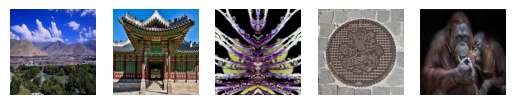

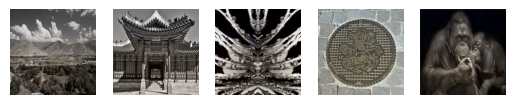

validation Output: 


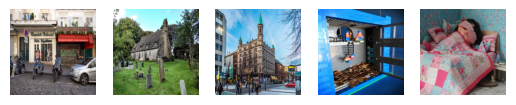

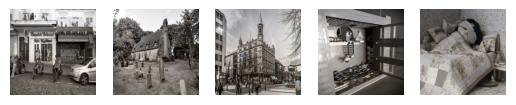


Saved model to ./ResnetBackbone_UNet_Full/UNet_50.pth.
Train Epoch: 51 [0/256 (0%)]	UNetLoss: 0.080239
Train Epoch: 51 [160/256 (62%)]	UNetLoss: 0.098926
Train Epoch: 52 [0/256 (0%)]	UNetLoss: 0.063466
Train Epoch: 52 [160/256 (62%)]	UNetLoss: 0.107940
Train Epoch: 53 [0/256 (0%)]	UNetLoss: 0.101054
Train Epoch: 53 [160/256 (62%)]	UNetLoss: 0.104412
Train Epoch: 54 [0/256 (0%)]	UNetLoss: 0.089429
Train Epoch: 54 [160/256 (62%)]	UNetLoss: 0.105526
Train Epoch: 55 [0/256 (0%)]	UNetLoss: 0.101257
Train Epoch: 55 [160/256 (62%)]	UNetLoss: 0.092581
Train Epoch: 56 [0/256 (0%)]	UNetLoss: 0.118509
Train Epoch: 56 [160/256 (62%)]	UNetLoss: 0.124904
Train Epoch: 57 [0/256 (0%)]	UNetLoss: 0.107447
Train Epoch: 57 [160/256 (62%)]	UNetLoss: 0.091841
Train Epoch: 58 [0/256 (0%)]	UNetLoss: 0.077676
Train Epoch: 58 [160/256 (62%)]	UNetLoss: 0.093269
Train Epoch: 59 [0/256 (0%)]	UNetLoss: 0.097385
Train Epoch: 59 [160/256 (62%)]	UNetLoss: 0.125123
Train Epoch: 60 [0/256 (0%)]	UNetLoss: 0.082351
Train

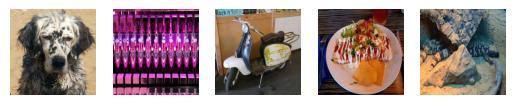

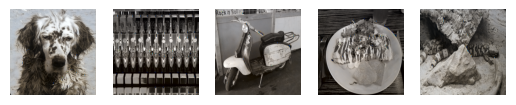

validation Output: 


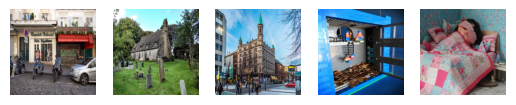

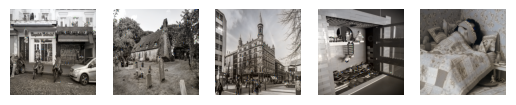


Saved model to ./ResnetBackbone_UNet_Full/UNet_100.pth.
Train Epoch: 101 [0/256 (0%)]	UNetLoss: 0.101184
Train Epoch: 101 [160/256 (62%)]	UNetLoss: 0.117218
Train Epoch: 102 [0/256 (0%)]	UNetLoss: 0.080216
Train Epoch: 102 [160/256 (62%)]	UNetLoss: 0.117198
Train Epoch: 103 [0/256 (0%)]	UNetLoss: 0.083145
Train Epoch: 103 [160/256 (62%)]	UNetLoss: 0.098386
Train Epoch: 104 [0/256 (0%)]	UNetLoss: 0.114846
Train Epoch: 104 [160/256 (62%)]	UNetLoss: 0.082230
Train Epoch: 105 [0/256 (0%)]	UNetLoss: 0.112037
Train Epoch: 105 [160/256 (62%)]	UNetLoss: 0.101234
Train Epoch: 106 [0/256 (0%)]	UNetLoss: 0.076267
Train Epoch: 106 [160/256 (62%)]	UNetLoss: 0.077674
Train Epoch: 107 [0/256 (0%)]	UNetLoss: 0.099127
Train Epoch: 107 [160/256 (62%)]	UNetLoss: 0.088171
Train Epoch: 108 [0/256 (0%)]	UNetLoss: 0.103266
Train Epoch: 108 [160/256 (62%)]	UNetLoss: 0.092022
Train Epoch: 109 [0/256 (0%)]	UNetLoss: 0.122331
Train Epoch: 109 [160/256 (62%)]	UNetLoss: 0.090868
Train Epoch: 110 [0/256 (0%)]	UNet

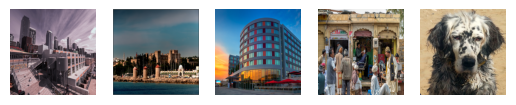

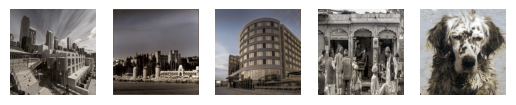

validation Output: 


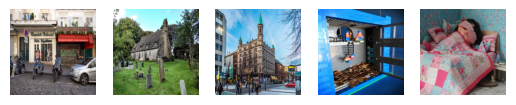

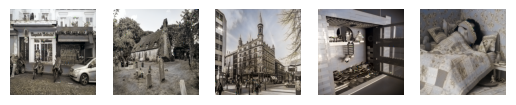


Saved model to ./ResnetBackbone_UNet_Full/UNet_150.pth.
Train Epoch: 151 [0/256 (0%)]	UNetLoss: 0.084071
Train Epoch: 151 [160/256 (62%)]	UNetLoss: 0.082187
Train Epoch: 152 [0/256 (0%)]	UNetLoss: 0.087623
Train Epoch: 152 [160/256 (62%)]	UNetLoss: 0.125269
Train Epoch: 153 [0/256 (0%)]	UNetLoss: 0.064491
Train Epoch: 153 [160/256 (62%)]	UNetLoss: 0.105232
Train Epoch: 154 [0/256 (0%)]	UNetLoss: 0.114300
Train Epoch: 154 [160/256 (62%)]	UNetLoss: 0.086044
Train Epoch: 155 [0/256 (0%)]	UNetLoss: 0.101965
Train Epoch: 155 [160/256 (62%)]	UNetLoss: 0.121833
Train Epoch: 156 [0/256 (0%)]	UNetLoss: 0.078528
Train Epoch: 156 [160/256 (62%)]	UNetLoss: 0.097257
Train Epoch: 157 [0/256 (0%)]	UNetLoss: 0.113958
Train Epoch: 157 [160/256 (62%)]	UNetLoss: 0.079117
Train Epoch: 158 [0/256 (0%)]	UNetLoss: 0.106939
Train Epoch: 158 [160/256 (62%)]	UNetLoss: 0.089843
Train Epoch: 159 [0/256 (0%)]	UNetLoss: 0.106495
Train Epoch: 159 [160/256 (62%)]	UNetLoss: 0.128150
Train Epoch: 160 [0/256 (0%)]	UNet

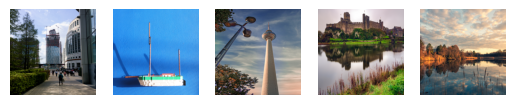

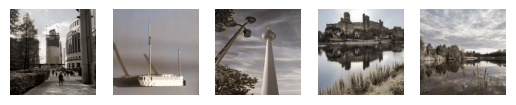

validation Output: 


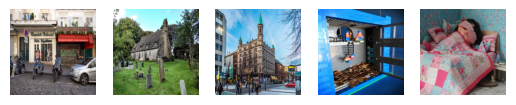

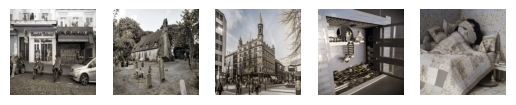


Saved model to ./ResnetBackbone_UNet_Full/UNet_200.pth.
Train Epoch: 201 [0/256 (0%)]	UNetLoss: 0.082301
Train Epoch: 201 [160/256 (62%)]	UNetLoss: 0.099448
Train Epoch: 202 [0/256 (0%)]	UNetLoss: 0.084942
Train Epoch: 202 [160/256 (62%)]	UNetLoss: 0.100043
Train Epoch: 203 [0/256 (0%)]	UNetLoss: 0.088622
Train Epoch: 203 [160/256 (62%)]	UNetLoss: 0.100438
Train Epoch: 204 [0/256 (0%)]	UNetLoss: 0.105120
Train Epoch: 204 [160/256 (62%)]	UNetLoss: 0.073722
Train Epoch: 205 [0/256 (0%)]	UNetLoss: 0.103970
Train Epoch: 205 [160/256 (62%)]	UNetLoss: 0.095963
Train Epoch: 206 [0/256 (0%)]	UNetLoss: 0.088766
Train Epoch: 206 [160/256 (62%)]	UNetLoss: 0.090981
Train Epoch: 207 [0/256 (0%)]	UNetLoss: 0.079371
Train Epoch: 207 [160/256 (62%)]	UNetLoss: 0.084397
Train Epoch: 208 [0/256 (0%)]	UNetLoss: 0.093912
Train Epoch: 208 [160/256 (62%)]	UNetLoss: 0.081451
Train Epoch: 209 [0/256 (0%)]	UNetLoss: 0.101976
Train Epoch: 209 [160/256 (62%)]	UNetLoss: 0.096355
Train Epoch: 210 [0/256 (0%)]	UNet

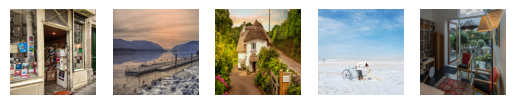

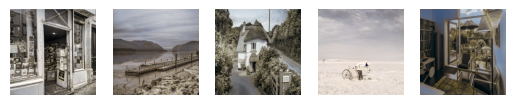

validation Output: 


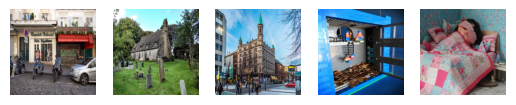

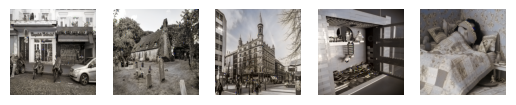


Saved model to ./ResnetBackbone_UNet_Full/UNet_250.pth.
Train Epoch: 251 [0/256 (0%)]	UNetLoss: 0.089072
Train Epoch: 251 [160/256 (62%)]	UNetLoss: 0.075030
Train Epoch: 252 [0/256 (0%)]	UNetLoss: 0.099645
Train Epoch: 252 [160/256 (62%)]	UNetLoss: 0.082553
Train Epoch: 253 [0/256 (0%)]	UNetLoss: 0.112279
Train Epoch: 253 [160/256 (62%)]	UNetLoss: 0.078058
Train Epoch: 254 [0/256 (0%)]	UNetLoss: 0.092960
Train Epoch: 254 [160/256 (62%)]	UNetLoss: 0.113964
Train Epoch: 255 [0/256 (0%)]	UNetLoss: 0.090696
Train Epoch: 255 [160/256 (62%)]	UNetLoss: 0.102921
Train Epoch: 256 [0/256 (0%)]	UNetLoss: 0.103783
Train Epoch: 256 [160/256 (62%)]	UNetLoss: 0.091355
Train Epoch: 257 [0/256 (0%)]	UNetLoss: 0.074051
Train Epoch: 257 [160/256 (62%)]	UNetLoss: 0.085105
Train Epoch: 258 [0/256 (0%)]	UNetLoss: 0.117007
Train Epoch: 258 [160/256 (62%)]	UNetLoss: 0.103574
Train Epoch: 259 [0/256 (0%)]	UNetLoss: 0.093623
Train Epoch: 259 [160/256 (62%)]	UNetLoss: 0.081196
Train Epoch: 260 [0/256 (0%)]	UNet

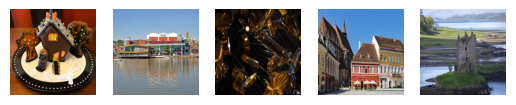

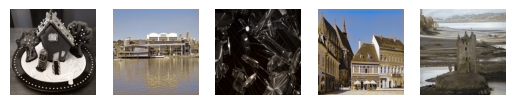

validation Output: 


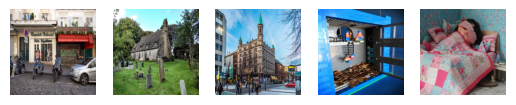

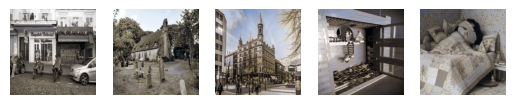


Saved model to ./ResnetBackbone_UNet_Full/UNet_300.pth.
Train Epoch: 301 [0/256 (0%)]	UNetLoss: 0.071932
Train Epoch: 301 [160/256 (62%)]	UNetLoss: 0.110926
Train Epoch: 302 [0/256 (0%)]	UNetLoss: 0.082926
Train Epoch: 302 [160/256 (62%)]	UNetLoss: 0.097936
Train Epoch: 303 [0/256 (0%)]	UNetLoss: 0.075001
Train Epoch: 303 [160/256 (62%)]	UNetLoss: 0.085236
Train Epoch: 304 [0/256 (0%)]	UNetLoss: 0.107528
Train Epoch: 304 [160/256 (62%)]	UNetLoss: 0.113830
Train Epoch: 305 [0/256 (0%)]	UNetLoss: 0.091461
Train Epoch: 305 [160/256 (62%)]	UNetLoss: 0.084665
Train Epoch: 306 [0/256 (0%)]	UNetLoss: 0.096934
Train Epoch: 306 [160/256 (62%)]	UNetLoss: 0.086678
Train Epoch: 307 [0/256 (0%)]	UNetLoss: 0.120849
Train Epoch: 307 [160/256 (62%)]	UNetLoss: 0.067786
Train Epoch: 308 [0/256 (0%)]	UNetLoss: 0.091421
Train Epoch: 308 [160/256 (62%)]	UNetLoss: 0.093825
Train Epoch: 309 [0/256 (0%)]	UNetLoss: 0.085365
Train Epoch: 309 [160/256 (62%)]	UNetLoss: 0.086137
Train Epoch: 310 [0/256 (0%)]	UNet

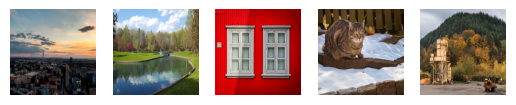

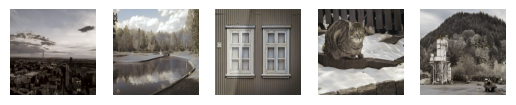

validation Output: 


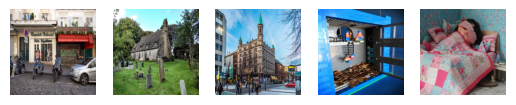

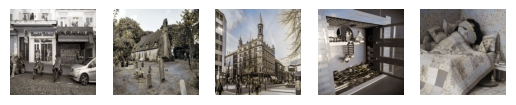


Saved model to ./ResnetBackbone_UNet_Full/UNet_350.pth.
Train Epoch: 351 [0/256 (0%)]	UNetLoss: 0.087715
Train Epoch: 351 [160/256 (62%)]	UNetLoss: 0.069705
Train Epoch: 352 [0/256 (0%)]	UNetLoss: 0.081099
Train Epoch: 352 [160/256 (62%)]	UNetLoss: 0.099485
Train Epoch: 353 [0/256 (0%)]	UNetLoss: 0.120607
Train Epoch: 353 [160/256 (62%)]	UNetLoss: 0.105705
Train Epoch: 354 [0/256 (0%)]	UNetLoss: 0.092161
Train Epoch: 354 [160/256 (62%)]	UNetLoss: 0.089006
Train Epoch: 355 [0/256 (0%)]	UNetLoss: 0.081190
Train Epoch: 355 [160/256 (62%)]	UNetLoss: 0.072763
Train Epoch: 356 [0/256 (0%)]	UNetLoss: 0.081430
Train Epoch: 356 [160/256 (62%)]	UNetLoss: 0.077431
Train Epoch: 357 [0/256 (0%)]	UNetLoss: 0.093355
Train Epoch: 357 [160/256 (62%)]	UNetLoss: 0.086028
Train Epoch: 358 [0/256 (0%)]	UNetLoss: 0.079485
Train Epoch: 358 [160/256 (62%)]	UNetLoss: 0.088157
Train Epoch: 359 [0/256 (0%)]	UNetLoss: 0.088603
Train Epoch: 359 [160/256 (62%)]	UNetLoss: 0.082087
Train Epoch: 360 [0/256 (0%)]	UNet

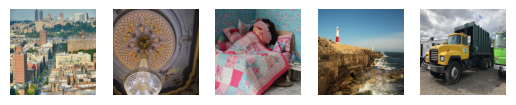

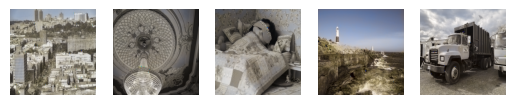

validation Output: 


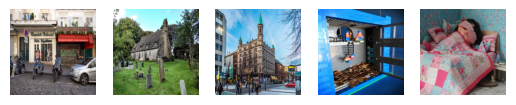

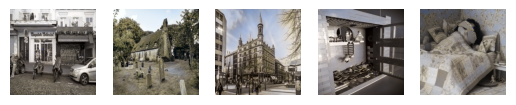


Saved model to ./ResnetBackbone_UNet_Full/UNet_400.pth.
Train Epoch: 401 [0/256 (0%)]	UNetLoss: 0.109151
Train Epoch: 401 [160/256 (62%)]	UNetLoss: 0.086177
Train Epoch: 402 [0/256 (0%)]	UNetLoss: 0.098247
Train Epoch: 402 [160/256 (62%)]	UNetLoss: 0.100970
Train Epoch: 403 [0/256 (0%)]	UNetLoss: 0.104585
Train Epoch: 403 [160/256 (62%)]	UNetLoss: 0.064432
Train Epoch: 404 [0/256 (0%)]	UNetLoss: 0.081128
Train Epoch: 404 [160/256 (62%)]	UNetLoss: 0.080523
Train Epoch: 405 [0/256 (0%)]	UNetLoss: 0.091306
Train Epoch: 405 [160/256 (62%)]	UNetLoss: 0.116543
Train Epoch: 406 [0/256 (0%)]	UNetLoss: 0.084307
Train Epoch: 406 [160/256 (62%)]	UNetLoss: 0.088296
Train Epoch: 407 [0/256 (0%)]	UNetLoss: 0.093225
Train Epoch: 407 [160/256 (62%)]	UNetLoss: 0.080130
Train Epoch: 408 [0/256 (0%)]	UNetLoss: 0.098897
Train Epoch: 408 [160/256 (62%)]	UNetLoss: 0.084820
Train Epoch: 409 [0/256 (0%)]	UNetLoss: 0.092520
Train Epoch: 409 [160/256 (62%)]	UNetLoss: 0.071696
Train Epoch: 410 [0/256 (0%)]	UNet

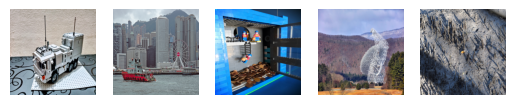

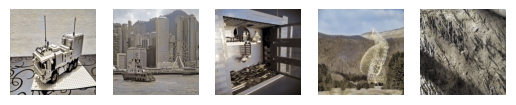

validation Output: 


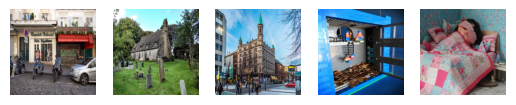

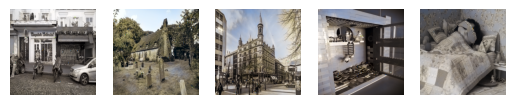


Saved model to ./ResnetBackbone_UNet_Full/UNet_450.pth.
Train Epoch: 451 [0/256 (0%)]	UNetLoss: 0.091894
Train Epoch: 451 [160/256 (62%)]	UNetLoss: 0.092481
Train Epoch: 452 [0/256 (0%)]	UNetLoss: 0.081184
Train Epoch: 452 [160/256 (62%)]	UNetLoss: 0.078152
Train Epoch: 453 [0/256 (0%)]	UNetLoss: 0.093070
Train Epoch: 453 [160/256 (62%)]	UNetLoss: 0.103331
Train Epoch: 454 [0/256 (0%)]	UNetLoss: 0.086035
Train Epoch: 454 [160/256 (62%)]	UNetLoss: 0.087899
Train Epoch: 455 [0/256 (0%)]	UNetLoss: 0.094552
Train Epoch: 455 [160/256 (62%)]	UNetLoss: 0.077603
Train Epoch: 456 [0/256 (0%)]	UNetLoss: 0.107458
Train Epoch: 456 [160/256 (62%)]	UNetLoss: 0.093691
Train Epoch: 457 [0/256 (0%)]	UNetLoss: 0.089010
Train Epoch: 457 [160/256 (62%)]	UNetLoss: 0.080047
Train Epoch: 458 [0/256 (0%)]	UNetLoss: 0.078001
Train Epoch: 458 [160/256 (62%)]	UNetLoss: 0.087732
Train Epoch: 459 [0/256 (0%)]	UNetLoss: 0.090927
Train Epoch: 459 [160/256 (62%)]	UNetLoss: 0.094472
Train Epoch: 460 [0/256 (0%)]	UNet

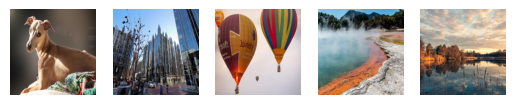

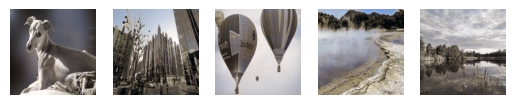

validation Output: 


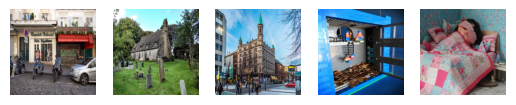

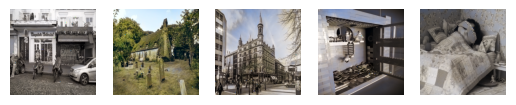


Saved model to ./ResnetBackbone_UNet_Full/UNet_500.pth.
Train Epoch: 501 [0/256 (0%)]	UNetLoss: 0.075094
Train Epoch: 501 [160/256 (62%)]	UNetLoss: 0.074097
Train Epoch: 502 [0/256 (0%)]	UNetLoss: 0.075335
Train Epoch: 502 [160/256 (62%)]	UNetLoss: 0.106656
Train Epoch: 503 [0/256 (0%)]	UNetLoss: 0.091357
Train Epoch: 503 [160/256 (62%)]	UNetLoss: 0.089383
Train Epoch: 504 [0/256 (0%)]	UNetLoss: 0.080546
Train Epoch: 504 [160/256 (62%)]	UNetLoss: 0.094341
Train Epoch: 505 [0/256 (0%)]	UNetLoss: 0.102655
Train Epoch: 505 [160/256 (62%)]	UNetLoss: 0.080754
Train Epoch: 506 [0/256 (0%)]	UNetLoss: 0.124521
Train Epoch: 506 [160/256 (62%)]	UNetLoss: 0.068706
Train Epoch: 507 [0/256 (0%)]	UNetLoss: 0.091226
Train Epoch: 507 [160/256 (62%)]	UNetLoss: 0.081583
Train Epoch: 508 [0/256 (0%)]	UNetLoss: 0.073711
Train Epoch: 508 [160/256 (62%)]	UNetLoss: 0.074048
Train Epoch: 509 [0/256 (0%)]	UNetLoss: 0.074768
Train Epoch: 509 [160/256 (62%)]	UNetLoss: 0.088768
Train Epoch: 510 [0/256 (0%)]	UNet

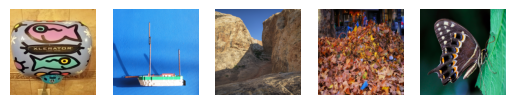

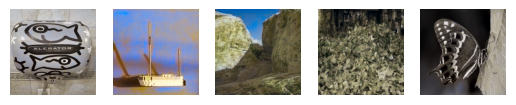

validation Output: 


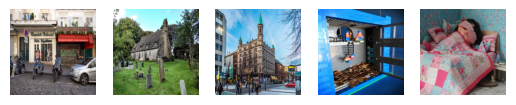

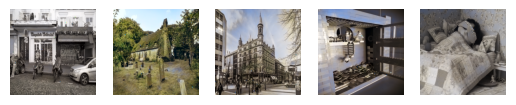


Saved model to ./ResnetBackbone_UNet_Full/UNet_550.pth.
Train Epoch: 551 [0/256 (0%)]	UNetLoss: 0.078119
Train Epoch: 551 [160/256 (62%)]	UNetLoss: 0.086843
Train Epoch: 552 [0/256 (0%)]	UNetLoss: 0.088101
Train Epoch: 552 [160/256 (62%)]	UNetLoss: 0.102386
Train Epoch: 553 [0/256 (0%)]	UNetLoss: 0.080997
Train Epoch: 553 [160/256 (62%)]	UNetLoss: 0.106750
Train Epoch: 554 [0/256 (0%)]	UNetLoss: 0.078406
Train Epoch: 554 [160/256 (62%)]	UNetLoss: 0.071201
Train Epoch: 555 [0/256 (0%)]	UNetLoss: 0.107642
Train Epoch: 555 [160/256 (62%)]	UNetLoss: 0.070256
Train Epoch: 556 [0/256 (0%)]	UNetLoss: 0.081413
Train Epoch: 556 [160/256 (62%)]	UNetLoss: 0.082213
Train Epoch: 557 [0/256 (0%)]	UNetLoss: 0.078540
Train Epoch: 557 [160/256 (62%)]	UNetLoss: 0.101814
Train Epoch: 558 [0/256 (0%)]	UNetLoss: 0.083681
Train Epoch: 558 [160/256 (62%)]	UNetLoss: 0.089887
Train Epoch: 559 [0/256 (0%)]	UNetLoss: 0.119520
Train Epoch: 559 [160/256 (62%)]	UNetLoss: 0.081564
Train Epoch: 560 [0/256 (0%)]	UNet

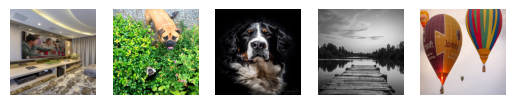

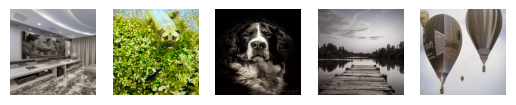

validation Output: 


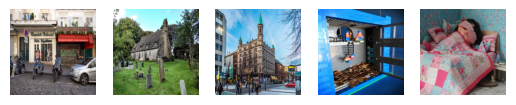

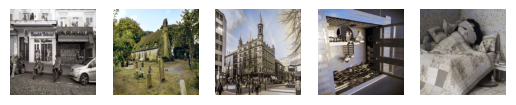


Saved model to ./ResnetBackbone_UNet_Full/UNet_600.pth.
Train Epoch: 601 [0/256 (0%)]	UNetLoss: 0.097499
Train Epoch: 601 [160/256 (62%)]	UNetLoss: 0.079674
Train Epoch: 602 [0/256 (0%)]	UNetLoss: 0.069010
Train Epoch: 602 [160/256 (62%)]	UNetLoss: 0.078972
Train Epoch: 603 [0/256 (0%)]	UNetLoss: 0.058153
Train Epoch: 603 [160/256 (62%)]	UNetLoss: 0.090488
Train Epoch: 604 [0/256 (0%)]	UNetLoss: 0.090577
Train Epoch: 604 [160/256 (62%)]	UNetLoss: 0.105068
Train Epoch: 605 [0/256 (0%)]	UNetLoss: 0.086560
Train Epoch: 605 [160/256 (62%)]	UNetLoss: 0.093612
Train Epoch: 606 [0/256 (0%)]	UNetLoss: 0.066882
Train Epoch: 606 [160/256 (62%)]	UNetLoss: 0.090175
Train Epoch: 607 [0/256 (0%)]	UNetLoss: 0.077696
Train Epoch: 607 [160/256 (62%)]	UNetLoss: 0.085065
Train Epoch: 608 [0/256 (0%)]	UNetLoss: 0.074160
Train Epoch: 608 [160/256 (62%)]	UNetLoss: 0.086007
Train Epoch: 609 [0/256 (0%)]	UNetLoss: 0.083828
Train Epoch: 609 [160/256 (62%)]	UNetLoss: 0.067344
Train Epoch: 610 [0/256 (0%)]	UNet

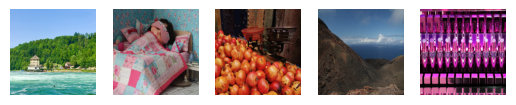

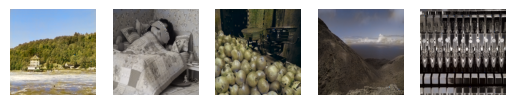

validation Output: 


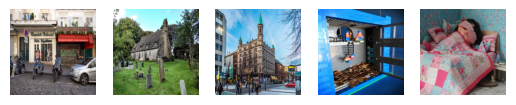

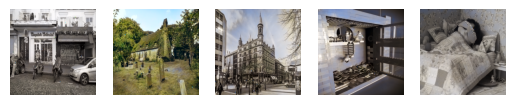


Saved model to ./ResnetBackbone_UNet_Full/UNet_650.pth.
Train Epoch: 651 [0/256 (0%)]	UNetLoss: 0.090514
Train Epoch: 651 [160/256 (62%)]	UNetLoss: 0.067766
Train Epoch: 652 [0/256 (0%)]	UNetLoss: 0.073988
Train Epoch: 652 [160/256 (62%)]	UNetLoss: 0.094199
Train Epoch: 653 [0/256 (0%)]	UNetLoss: 0.087615
Train Epoch: 653 [160/256 (62%)]	UNetLoss: 0.108764
Train Epoch: 654 [0/256 (0%)]	UNetLoss: 0.065522
Train Epoch: 654 [160/256 (62%)]	UNetLoss: 0.084843
Train Epoch: 655 [0/256 (0%)]	UNetLoss: 0.080653
Train Epoch: 655 [160/256 (62%)]	UNetLoss: 0.081602
Train Epoch: 656 [0/256 (0%)]	UNetLoss: 0.085059
Train Epoch: 656 [160/256 (62%)]	UNetLoss: 0.091507
Train Epoch: 657 [0/256 (0%)]	UNetLoss: 0.097628
Train Epoch: 657 [160/256 (62%)]	UNetLoss: 0.087723
Train Epoch: 658 [0/256 (0%)]	UNetLoss: 0.083205
Train Epoch: 658 [160/256 (62%)]	UNetLoss: 0.109902
Train Epoch: 659 [0/256 (0%)]	UNetLoss: 0.069723
Train Epoch: 659 [160/256 (62%)]	UNetLoss: 0.092337
Train Epoch: 660 [0/256 (0%)]	UNet

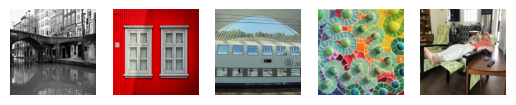

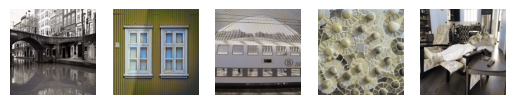

validation Output: 


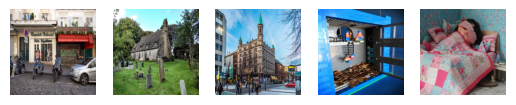

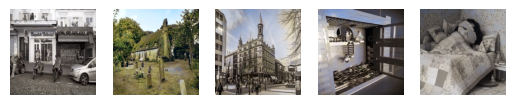


Saved model to ./ResnetBackbone_UNet_Full/UNet_700.pth.
Train Epoch: 701 [0/256 (0%)]	UNetLoss: 0.084789
Train Epoch: 701 [160/256 (62%)]	UNetLoss: 0.082057
Train Epoch: 702 [0/256 (0%)]	UNetLoss: 0.085162
Train Epoch: 702 [160/256 (62%)]	UNetLoss: 0.076181
Train Epoch: 703 [0/256 (0%)]	UNetLoss: 0.104025
Train Epoch: 703 [160/256 (62%)]	UNetLoss: 0.058141
Train Epoch: 704 [0/256 (0%)]	UNetLoss: 0.066898
Train Epoch: 704 [160/256 (62%)]	UNetLoss: 0.086596
Train Epoch: 705 [0/256 (0%)]	UNetLoss: 0.100935
Train Epoch: 705 [160/256 (62%)]	UNetLoss: 0.065432
Train Epoch: 706 [0/256 (0%)]	UNetLoss: 0.118026
Train Epoch: 706 [160/256 (62%)]	UNetLoss: 0.105240
Train Epoch: 707 [0/256 (0%)]	UNetLoss: 0.077051
Train Epoch: 707 [160/256 (62%)]	UNetLoss: 0.088525
Train Epoch: 708 [0/256 (0%)]	UNetLoss: 0.079889
Train Epoch: 708 [160/256 (62%)]	UNetLoss: 0.073353
Train Epoch: 709 [0/256 (0%)]	UNetLoss: 0.076101
Train Epoch: 709 [160/256 (62%)]	UNetLoss: 0.093352
Train Epoch: 710 [0/256 (0%)]	UNet

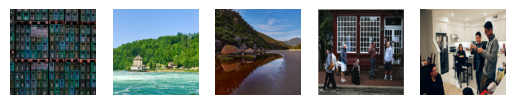

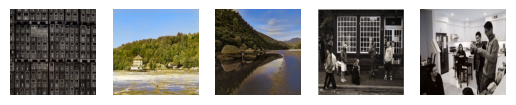

validation Output: 


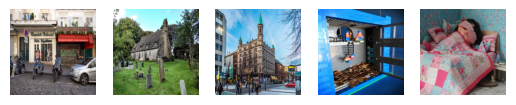

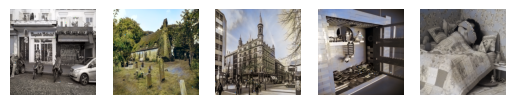


Saved model to ./ResnetBackbone_UNet_Full/UNet_750.pth.
Train Epoch: 751 [0/256 (0%)]	UNetLoss: 0.080691
Train Epoch: 751 [160/256 (62%)]	UNetLoss: 0.069251
Train Epoch: 752 [0/256 (0%)]	UNetLoss: 0.080406
Train Epoch: 752 [160/256 (62%)]	UNetLoss: 0.074593
Train Epoch: 753 [0/256 (0%)]	UNetLoss: 0.088453
Train Epoch: 753 [160/256 (62%)]	UNetLoss: 0.102168
Train Epoch: 754 [0/256 (0%)]	UNetLoss: 0.108930
Train Epoch: 754 [160/256 (62%)]	UNetLoss: 0.089537
Train Epoch: 755 [0/256 (0%)]	UNetLoss: 0.106194
Train Epoch: 755 [160/256 (62%)]	UNetLoss: 0.079383
Train Epoch: 756 [0/256 (0%)]	UNetLoss: 0.103622
Train Epoch: 756 [160/256 (62%)]	UNetLoss: 0.072396
Train Epoch: 757 [0/256 (0%)]	UNetLoss: 0.084785
Train Epoch: 757 [160/256 (62%)]	UNetLoss: 0.098049
Train Epoch: 758 [0/256 (0%)]	UNetLoss: 0.098058
Train Epoch: 758 [160/256 (62%)]	UNetLoss: 0.102199
Train Epoch: 759 [0/256 (0%)]	UNetLoss: 0.090364
Train Epoch: 759 [160/256 (62%)]	UNetLoss: 0.089227
Train Epoch: 760 [0/256 (0%)]	UNet

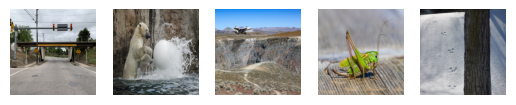

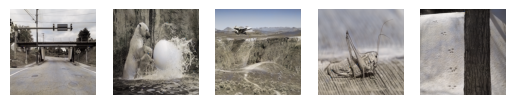

validation Output: 


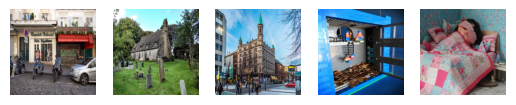

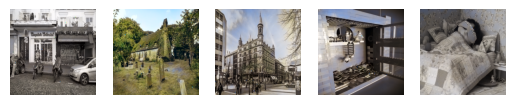


Saved model to ./ResnetBackbone_UNet_Full/UNet_800.pth.
Train Epoch: 801 [0/256 (0%)]	UNetLoss: 0.085094
Train Epoch: 801 [160/256 (62%)]	UNetLoss: 0.079364
Train Epoch: 802 [0/256 (0%)]	UNetLoss: 0.089395
Train Epoch: 802 [160/256 (62%)]	UNetLoss: 0.118691
Train Epoch: 803 [0/256 (0%)]	UNetLoss: 0.080518
Train Epoch: 803 [160/256 (62%)]	UNetLoss: 0.105479
Train Epoch: 804 [0/256 (0%)]	UNetLoss: 0.092446
Train Epoch: 804 [160/256 (62%)]	UNetLoss: 0.091859
Train Epoch: 805 [0/256 (0%)]	UNetLoss: 0.097804
Train Epoch: 805 [160/256 (62%)]	UNetLoss: 0.072685
Train Epoch: 806 [0/256 (0%)]	UNetLoss: 0.090108
Train Epoch: 806 [160/256 (62%)]	UNetLoss: 0.074646
Train Epoch: 807 [0/256 (0%)]	UNetLoss: 0.083787
Train Epoch: 807 [160/256 (62%)]	UNetLoss: 0.085015
Train Epoch: 808 [0/256 (0%)]	UNetLoss: 0.105666
Train Epoch: 808 [160/256 (62%)]	UNetLoss: 0.102860
Train Epoch: 809 [0/256 (0%)]	UNetLoss: 0.080557
Train Epoch: 809 [160/256 (62%)]	UNetLoss: 0.100448
Train Epoch: 810 [0/256 (0%)]	UNet

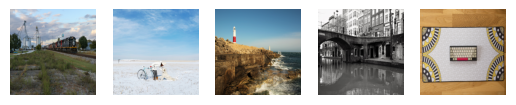

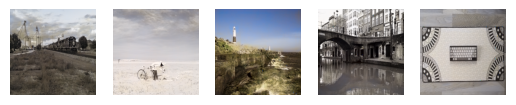

validation Output: 


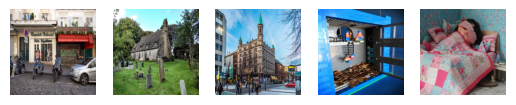

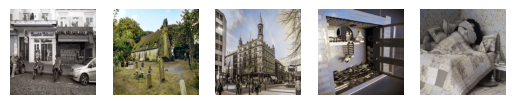


Saved model to ./ResnetBackbone_UNet_Full/UNet_850.pth.
Train Epoch: 851 [0/256 (0%)]	UNetLoss: 0.071568
Train Epoch: 851 [160/256 (62%)]	UNetLoss: 0.097470
Train Epoch: 852 [0/256 (0%)]	UNetLoss: 0.102101
Train Epoch: 852 [160/256 (62%)]	UNetLoss: 0.080005
Train Epoch: 853 [0/256 (0%)]	UNetLoss: 0.094378
Train Epoch: 853 [160/256 (62%)]	UNetLoss: 0.073969
Train Epoch: 854 [0/256 (0%)]	UNetLoss: 0.113852
Train Epoch: 854 [160/256 (62%)]	UNetLoss: 0.076366
Train Epoch: 855 [0/256 (0%)]	UNetLoss: 0.077513
Train Epoch: 855 [160/256 (62%)]	UNetLoss: 0.081032
Train Epoch: 856 [0/256 (0%)]	UNetLoss: 0.079118
Train Epoch: 856 [160/256 (62%)]	UNetLoss: 0.057959
Train Epoch: 857 [0/256 (0%)]	UNetLoss: 0.104101
Train Epoch: 857 [160/256 (62%)]	UNetLoss: 0.075825
Train Epoch: 858 [0/256 (0%)]	UNetLoss: 0.088549
Train Epoch: 858 [160/256 (62%)]	UNetLoss: 0.086288
Train Epoch: 859 [0/256 (0%)]	UNetLoss: 0.094300
Train Epoch: 859 [160/256 (62%)]	UNetLoss: 0.069361
Train Epoch: 860 [0/256 (0%)]	UNet

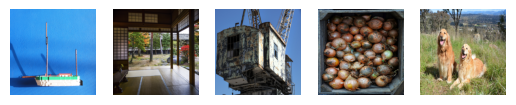

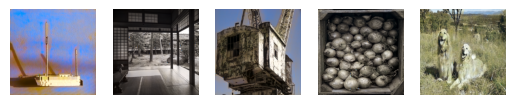

validation Output: 


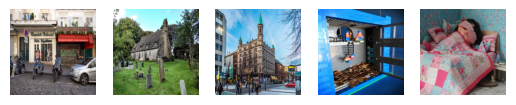

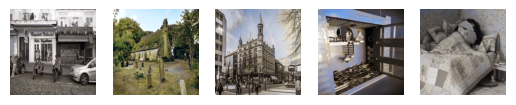


Saved model to ./ResnetBackbone_UNet_Full/UNet_900.pth.
Train Epoch: 901 [0/256 (0%)]	UNetLoss: 0.093881
Train Epoch: 901 [160/256 (62%)]	UNetLoss: 0.092032
Train Epoch: 902 [0/256 (0%)]	UNetLoss: 0.092289
Train Epoch: 902 [160/256 (62%)]	UNetLoss: 0.078861
Train Epoch: 903 [0/256 (0%)]	UNetLoss: 0.095068
Train Epoch: 903 [160/256 (62%)]	UNetLoss: 0.121775
Train Epoch: 904 [0/256 (0%)]	UNetLoss: 0.087449
Train Epoch: 904 [160/256 (62%)]	UNetLoss: 0.079675
Train Epoch: 905 [0/256 (0%)]	UNetLoss: 0.087659
Train Epoch: 905 [160/256 (62%)]	UNetLoss: 0.094375
Train Epoch: 906 [0/256 (0%)]	UNetLoss: 0.073678
Train Epoch: 906 [160/256 (62%)]	UNetLoss: 0.083689
Train Epoch: 907 [0/256 (0%)]	UNetLoss: 0.092712
Train Epoch: 907 [160/256 (62%)]	UNetLoss: 0.098371
Train Epoch: 908 [0/256 (0%)]	UNetLoss: 0.078033
Train Epoch: 908 [160/256 (62%)]	UNetLoss: 0.080046
Train Epoch: 909 [0/256 (0%)]	UNetLoss: 0.087915
Train Epoch: 909 [160/256 (62%)]	UNetLoss: 0.069443
Train Epoch: 910 [0/256 (0%)]	UNet

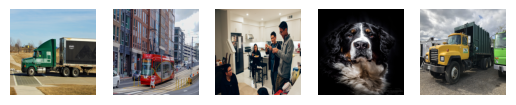

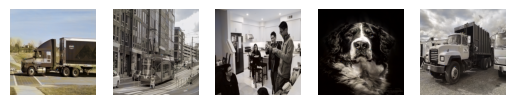

validation Output: 


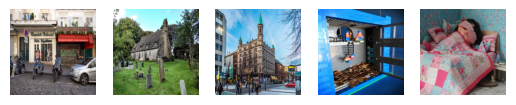

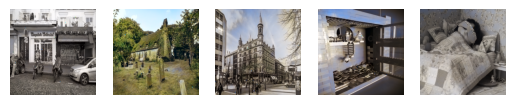


Saved model to ./ResnetBackbone_UNet_Full/UNet_950.pth.
Train Epoch: 951 [0/256 (0%)]	UNetLoss: 0.074216
Train Epoch: 951 [160/256 (62%)]	UNetLoss: 0.072500
Train Epoch: 952 [0/256 (0%)]	UNetLoss: 0.062024
Train Epoch: 952 [160/256 (62%)]	UNetLoss: 0.083998
Train Epoch: 953 [0/256 (0%)]	UNetLoss: 0.072437
Train Epoch: 953 [160/256 (62%)]	UNetLoss: 0.077109
Train Epoch: 954 [0/256 (0%)]	UNetLoss: 0.071900
Train Epoch: 954 [160/256 (62%)]	UNetLoss: 0.083854
Train Epoch: 955 [0/256 (0%)]	UNetLoss: 0.087493
Train Epoch: 955 [160/256 (62%)]	UNetLoss: 0.079726
Train Epoch: 956 [0/256 (0%)]	UNetLoss: 0.068077
Train Epoch: 956 [160/256 (62%)]	UNetLoss: 0.082042
Train Epoch: 957 [0/256 (0%)]	UNetLoss: 0.071709
Train Epoch: 957 [160/256 (62%)]	UNetLoss: 0.107560
Train Epoch: 958 [0/256 (0%)]	UNetLoss: 0.069272
Train Epoch: 958 [160/256 (62%)]	UNetLoss: 0.087527
Train Epoch: 959 [0/256 (0%)]	UNetLoss: 0.075861
Train Epoch: 959 [160/256 (62%)]	UNetLoss: 0.113105
Train Epoch: 960 [0/256 (0%)]	UNet

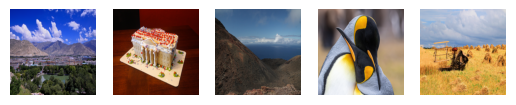

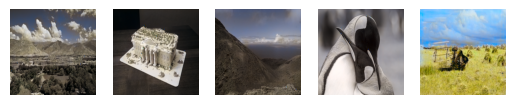

validation Output: 


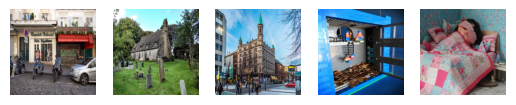

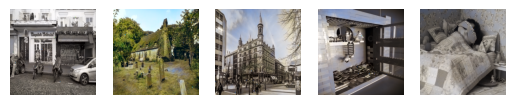


Saved model to ./ResnetBackbone_UNet_Full/UNet_1000.pth.
Train Epoch: 1001 [0/256 (0%)]	UNetLoss: 0.087347
Train Epoch: 1001 [160/256 (62%)]	UNetLoss: 0.093795
Train Epoch: 1002 [0/256 (0%)]	UNetLoss: 0.075896
Train Epoch: 1002 [160/256 (62%)]	UNetLoss: 0.117475
Train Epoch: 1003 [0/256 (0%)]	UNetLoss: 0.096295
Train Epoch: 1003 [160/256 (62%)]	UNetLoss: 0.104467
Train Epoch: 1004 [0/256 (0%)]	UNetLoss: 0.084637
Train Epoch: 1004 [160/256 (62%)]	UNetLoss: 0.086665
Train Epoch: 1005 [0/256 (0%)]	UNetLoss: 0.074675
Train Epoch: 1005 [160/256 (62%)]	UNetLoss: 0.070674
Train Epoch: 1006 [0/256 (0%)]	UNetLoss: 0.073057
Train Epoch: 1006 [160/256 (62%)]	UNetLoss: 0.089590
Train Epoch: 1007 [0/256 (0%)]	UNetLoss: 0.090030
Train Epoch: 1007 [160/256 (62%)]	UNetLoss: 0.084716
Train Epoch: 1008 [0/256 (0%)]	UNetLoss: 0.086186
Train Epoch: 1008 [160/256 (62%)]	UNetLoss: 0.063647
Train Epoch: 1009 [0/256 (0%)]	UNetLoss: 0.083161
Train Epoch: 1009 [160/256 (62%)]	UNetLoss: 0.070112
Train Epoch: 10

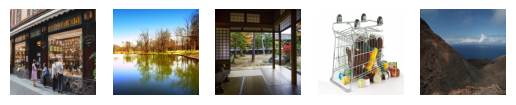

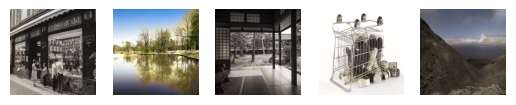

validation Output: 


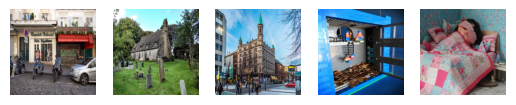

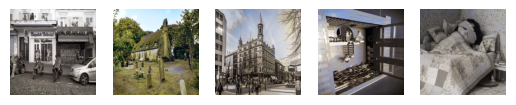


Saved model to ./ResnetBackbone_UNet_Full/UNet_1050.pth.
Train Epoch: 1051 [0/256 (0%)]	UNetLoss: 0.078139
Train Epoch: 1051 [160/256 (62%)]	UNetLoss: 0.093950
Train Epoch: 1052 [0/256 (0%)]	UNetLoss: 0.081547
Train Epoch: 1052 [160/256 (62%)]	UNetLoss: 0.078584
Train Epoch: 1053 [0/256 (0%)]	UNetLoss: 0.116187
Train Epoch: 1053 [160/256 (62%)]	UNetLoss: 0.066221
Train Epoch: 1054 [0/256 (0%)]	UNetLoss: 0.081234
Train Epoch: 1054 [160/256 (62%)]	UNetLoss: 0.086900
Train Epoch: 1055 [0/256 (0%)]	UNetLoss: 0.118558
Train Epoch: 1055 [160/256 (62%)]	UNetLoss: 0.089762
Train Epoch: 1056 [0/256 (0%)]	UNetLoss: 0.079031
Train Epoch: 1056 [160/256 (62%)]	UNetLoss: 0.088441
Train Epoch: 1057 [0/256 (0%)]	UNetLoss: 0.076968
Train Epoch: 1057 [160/256 (62%)]	UNetLoss: 0.074900
Train Epoch: 1058 [0/256 (0%)]	UNetLoss: 0.074226
Train Epoch: 1058 [160/256 (62%)]	UNetLoss: 0.126674
Train Epoch: 1059 [0/256 (0%)]	UNetLoss: 0.083826
Train Epoch: 1059 [160/256 (62%)]	UNetLoss: 0.079206
Train Epoch: 10

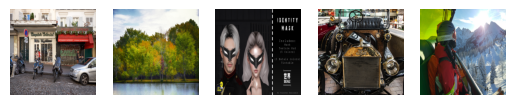

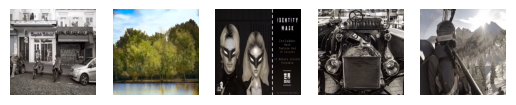

validation Output: 


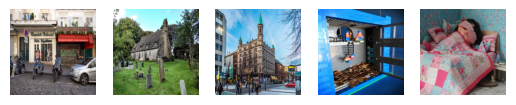

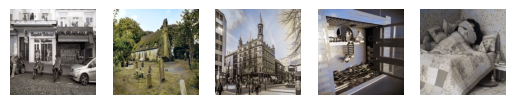


Saved model to ./ResnetBackbone_UNet_Full/UNet_1100.pth.
Train Epoch: 1101 [0/256 (0%)]	UNetLoss: 0.102163
Train Epoch: 1101 [160/256 (62%)]	UNetLoss: 0.065730
Train Epoch: 1102 [0/256 (0%)]	UNetLoss: 0.080073
Train Epoch: 1102 [160/256 (62%)]	UNetLoss: 0.087422
Train Epoch: 1103 [0/256 (0%)]	UNetLoss: 0.064625
Train Epoch: 1103 [160/256 (62%)]	UNetLoss: 0.084009
Train Epoch: 1104 [0/256 (0%)]	UNetLoss: 0.077792
Train Epoch: 1104 [160/256 (62%)]	UNetLoss: 0.089904
Train Epoch: 1105 [0/256 (0%)]	UNetLoss: 0.096694
Train Epoch: 1105 [160/256 (62%)]	UNetLoss: 0.099564
Train Epoch: 1106 [0/256 (0%)]	UNetLoss: 0.069412
Train Epoch: 1106 [160/256 (62%)]	UNetLoss: 0.080607
Train Epoch: 1107 [0/256 (0%)]	UNetLoss: 0.080547
Train Epoch: 1107 [160/256 (62%)]	UNetLoss: 0.079651
Train Epoch: 1108 [0/256 (0%)]	UNetLoss: 0.090643
Train Epoch: 1108 [160/256 (62%)]	UNetLoss: 0.076237
Train Epoch: 1109 [0/256 (0%)]	UNetLoss: 0.078785
Train Epoch: 1109 [160/256 (62%)]	UNetLoss: 0.093068
Train Epoch: 11

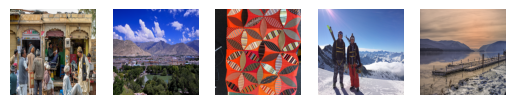

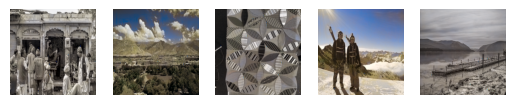

validation Output: 


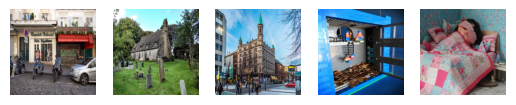

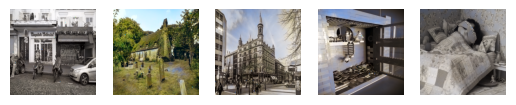


Saved model to ./ResnetBackbone_UNet_Full/UNet_1150.pth.
Train Epoch: 1151 [0/256 (0%)]	UNetLoss: 0.099231
Train Epoch: 1151 [160/256 (62%)]	UNetLoss: 0.088413
Train Epoch: 1152 [0/256 (0%)]	UNetLoss: 0.078769
Train Epoch: 1152 [160/256 (62%)]	UNetLoss: 0.080294
Train Epoch: 1153 [0/256 (0%)]	UNetLoss: 0.099228
Train Epoch: 1153 [160/256 (62%)]	UNetLoss: 0.087170
Train Epoch: 1154 [0/256 (0%)]	UNetLoss: 0.090262
Train Epoch: 1154 [160/256 (62%)]	UNetLoss: 0.104492
Train Epoch: 1155 [0/256 (0%)]	UNetLoss: 0.080939
Train Epoch: 1155 [160/256 (62%)]	UNetLoss: 0.084044
Train Epoch: 1156 [0/256 (0%)]	UNetLoss: 0.096665
Train Epoch: 1156 [160/256 (62%)]	UNetLoss: 0.074085
Train Epoch: 1157 [0/256 (0%)]	UNetLoss: 0.087355
Train Epoch: 1157 [160/256 (62%)]	UNetLoss: 0.087656
Train Epoch: 1158 [0/256 (0%)]	UNetLoss: 0.090843
Train Epoch: 1158 [160/256 (62%)]	UNetLoss: 0.109527
Train Epoch: 1159 [0/256 (0%)]	UNetLoss: 0.092231
Train Epoch: 1159 [160/256 (62%)]	UNetLoss: 0.080950
Train Epoch: 11

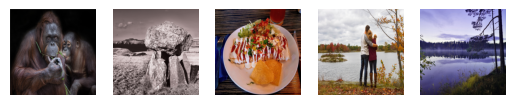

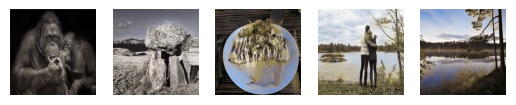

validation Output: 


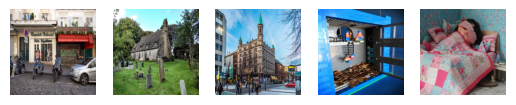

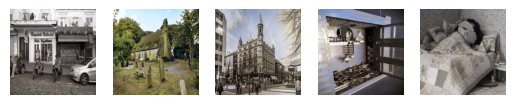


Saved model to ./ResnetBackbone_UNet_Full/UNet_1200.pth.
Train Epoch: 1201 [0/256 (0%)]	UNetLoss: 0.082741
Train Epoch: 1201 [160/256 (62%)]	UNetLoss: 0.088307
Train Epoch: 1202 [0/256 (0%)]	UNetLoss: 0.079844
Train Epoch: 1202 [160/256 (62%)]	UNetLoss: 0.090182
Train Epoch: 1203 [0/256 (0%)]	UNetLoss: 0.075565
Train Epoch: 1203 [160/256 (62%)]	UNetLoss: 0.085388
Train Epoch: 1204 [0/256 (0%)]	UNetLoss: 0.098617
Train Epoch: 1204 [160/256 (62%)]	UNetLoss: 0.082154
Train Epoch: 1205 [0/256 (0%)]	UNetLoss: 0.083414
Train Epoch: 1205 [160/256 (62%)]	UNetLoss: 0.085520
Train Epoch: 1206 [0/256 (0%)]	UNetLoss: 0.085519
Train Epoch: 1206 [160/256 (62%)]	UNetLoss: 0.094110
Train Epoch: 1207 [0/256 (0%)]	UNetLoss: 0.083353
Train Epoch: 1207 [160/256 (62%)]	UNetLoss: 0.085471
Train Epoch: 1208 [0/256 (0%)]	UNetLoss: 0.107947
Train Epoch: 1208 [160/256 (62%)]	UNetLoss: 0.082165
Train Epoch: 1209 [0/256 (0%)]	UNetLoss: 0.114197
Train Epoch: 1209 [160/256 (62%)]	UNetLoss: 0.096209
Train Epoch: 12

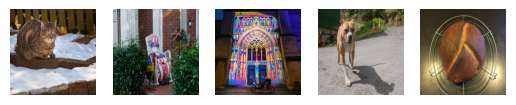

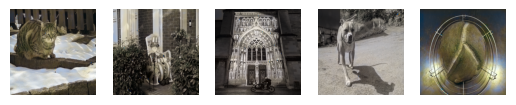

validation Output: 


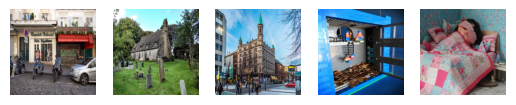

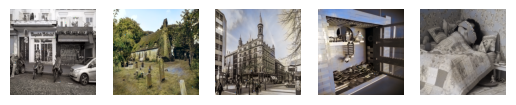


Saved model to ./ResnetBackbone_UNet_Full/UNet_1250.pth.
Train Epoch: 1251 [0/256 (0%)]	UNetLoss: 0.094220
Train Epoch: 1251 [160/256 (62%)]	UNetLoss: 0.081075
Train Epoch: 1252 [0/256 (0%)]	UNetLoss: 0.103319
Train Epoch: 1252 [160/256 (62%)]	UNetLoss: 0.076528
Train Epoch: 1253 [0/256 (0%)]	UNetLoss: 0.085005
Train Epoch: 1253 [160/256 (62%)]	UNetLoss: 0.084321
Train Epoch: 1254 [0/256 (0%)]	UNetLoss: 0.078343
Train Epoch: 1254 [160/256 (62%)]	UNetLoss: 0.073550
Train Epoch: 1255 [0/256 (0%)]	UNetLoss: 0.088534
Train Epoch: 1255 [160/256 (62%)]	UNetLoss: 0.079203
Train Epoch: 1256 [0/256 (0%)]	UNetLoss: 0.088264
Train Epoch: 1256 [160/256 (62%)]	UNetLoss: 0.079981
Train Epoch: 1257 [0/256 (0%)]	UNetLoss: 0.080885
Train Epoch: 1257 [160/256 (62%)]	UNetLoss: 0.086901
Train Epoch: 1258 [0/256 (0%)]	UNetLoss: 0.091977
Train Epoch: 1258 [160/256 (62%)]	UNetLoss: 0.072853
Train Epoch: 1259 [0/256 (0%)]	UNetLoss: 0.091474
Train Epoch: 1259 [160/256 (62%)]	UNetLoss: 0.092970
Train Epoch: 12

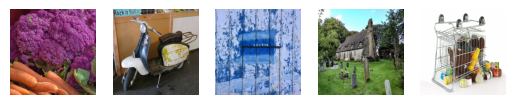

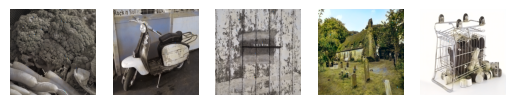

validation Output: 


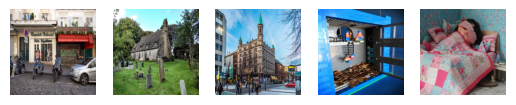

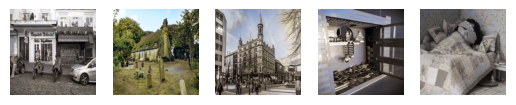


Saved model to ./ResnetBackbone_UNet_Full/UNet_1300.pth.
Train Epoch: 1301 [0/256 (0%)]	UNetLoss: 0.072097
Train Epoch: 1301 [160/256 (62%)]	UNetLoss: 0.072538
Train Epoch: 1302 [0/256 (0%)]	UNetLoss: 0.116450
Train Epoch: 1302 [160/256 (62%)]	UNetLoss: 0.082010
Train Epoch: 1303 [0/256 (0%)]	UNetLoss: 0.081506
Train Epoch: 1303 [160/256 (62%)]	UNetLoss: 0.100855
Train Epoch: 1304 [0/256 (0%)]	UNetLoss: 0.069467
Train Epoch: 1304 [160/256 (62%)]	UNetLoss: 0.071447
Train Epoch: 1305 [0/256 (0%)]	UNetLoss: 0.086289
Train Epoch: 1305 [160/256 (62%)]	UNetLoss: 0.079036
Train Epoch: 1306 [0/256 (0%)]	UNetLoss: 0.105563
Train Epoch: 1306 [160/256 (62%)]	UNetLoss: 0.086652
Train Epoch: 1307 [0/256 (0%)]	UNetLoss: 0.085142
Train Epoch: 1307 [160/256 (62%)]	UNetLoss: 0.086449
Train Epoch: 1308 [0/256 (0%)]	UNetLoss: 0.088553
Train Epoch: 1308 [160/256 (62%)]	UNetLoss: 0.083870
Train Epoch: 1309 [0/256 (0%)]	UNetLoss: 0.085865
Train Epoch: 1309 [160/256 (62%)]	UNetLoss: 0.089075
Train Epoch: 13

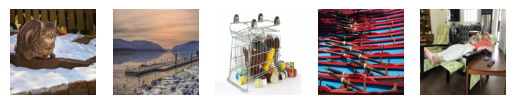

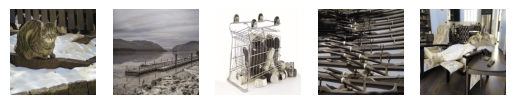

validation Output: 


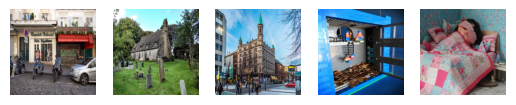

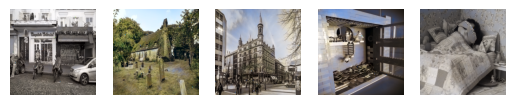


Saved model to ./ResnetBackbone_UNet_Full/UNet_1350.pth.
Train Epoch: 1351 [0/256 (0%)]	UNetLoss: 0.081935
Train Epoch: 1351 [160/256 (62%)]	UNetLoss: 0.099856
Train Epoch: 1352 [0/256 (0%)]	UNetLoss: 0.103798
Train Epoch: 1352 [160/256 (62%)]	UNetLoss: 0.077216
Train Epoch: 1353 [0/256 (0%)]	UNetLoss: 0.091942
Train Epoch: 1353 [160/256 (62%)]	UNetLoss: 0.069512
Train Epoch: 1354 [0/256 (0%)]	UNetLoss: 0.093267
Train Epoch: 1354 [160/256 (62%)]	UNetLoss: 0.088328
Train Epoch: 1355 [0/256 (0%)]	UNetLoss: 0.096973
Train Epoch: 1355 [160/256 (62%)]	UNetLoss: 0.091207
Train Epoch: 1356 [0/256 (0%)]	UNetLoss: 0.094442
Train Epoch: 1356 [160/256 (62%)]	UNetLoss: 0.065502
Train Epoch: 1357 [0/256 (0%)]	UNetLoss: 0.083253
Train Epoch: 1357 [160/256 (62%)]	UNetLoss: 0.106539
Train Epoch: 1358 [0/256 (0%)]	UNetLoss: 0.085769
Train Epoch: 1358 [160/256 (62%)]	UNetLoss: 0.078259
Train Epoch: 1359 [0/256 (0%)]	UNetLoss: 0.083212
Train Epoch: 1359 [160/256 (62%)]	UNetLoss: 0.082161
Train Epoch: 13

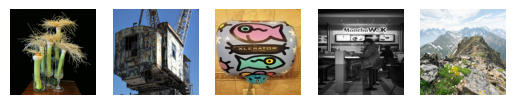

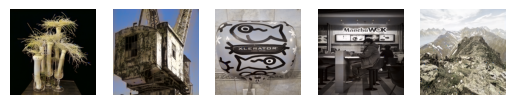

validation Output: 


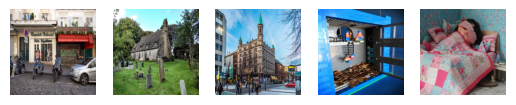

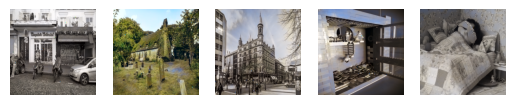


Saved model to ./ResnetBackbone_UNet_Full/UNet_1400.pth.
Train Epoch: 1401 [0/256 (0%)]	UNetLoss: 0.066171
Train Epoch: 1401 [160/256 (62%)]	UNetLoss: 0.077155
Train Epoch: 1402 [0/256 (0%)]	UNetLoss: 0.086886
Train Epoch: 1402 [160/256 (62%)]	UNetLoss: 0.096990
Train Epoch: 1403 [0/256 (0%)]	UNetLoss: 0.101989
Train Epoch: 1403 [160/256 (62%)]	UNetLoss: 0.078874
Train Epoch: 1404 [0/256 (0%)]	UNetLoss: 0.081983
Train Epoch: 1404 [160/256 (62%)]	UNetLoss: 0.067371
Train Epoch: 1405 [0/256 (0%)]	UNetLoss: 0.091917
Train Epoch: 1405 [160/256 (62%)]	UNetLoss: 0.079387
Train Epoch: 1406 [0/256 (0%)]	UNetLoss: 0.084711
Train Epoch: 1406 [160/256 (62%)]	UNetLoss: 0.080664
Train Epoch: 1407 [0/256 (0%)]	UNetLoss: 0.069152
Train Epoch: 1407 [160/256 (62%)]	UNetLoss: 0.085415
Train Epoch: 1408 [0/256 (0%)]	UNetLoss: 0.071667
Train Epoch: 1408 [160/256 (62%)]	UNetLoss: 0.082824
Train Epoch: 1409 [0/256 (0%)]	UNetLoss: 0.079111
Train Epoch: 1409 [160/256 (62%)]	UNetLoss: 0.073017
Train Epoch: 14

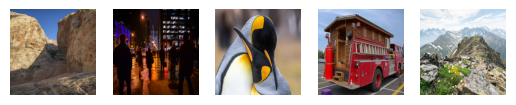

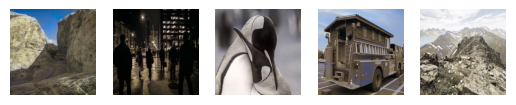

validation Output: 


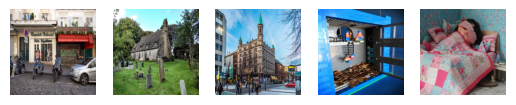

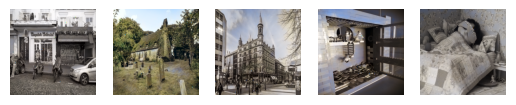


Saved model to ./ResnetBackbone_UNet_Full/UNet_1450.pth.
Train Epoch: 1451 [0/256 (0%)]	UNetLoss: 0.106077
Train Epoch: 1451 [160/256 (62%)]	UNetLoss: 0.069820
Train Epoch: 1452 [0/256 (0%)]	UNetLoss: 0.095731
Train Epoch: 1452 [160/256 (62%)]	UNetLoss: 0.066917
Train Epoch: 1453 [0/256 (0%)]	UNetLoss: 0.061741
Train Epoch: 1453 [160/256 (62%)]	UNetLoss: 0.098768
Train Epoch: 1454 [0/256 (0%)]	UNetLoss: 0.070679
Train Epoch: 1454 [160/256 (62%)]	UNetLoss: 0.072404
Train Epoch: 1455 [0/256 (0%)]	UNetLoss: 0.076825
Train Epoch: 1455 [160/256 (62%)]	UNetLoss: 0.071342
Train Epoch: 1456 [0/256 (0%)]	UNetLoss: 0.083645
Train Epoch: 1456 [160/256 (62%)]	UNetLoss: 0.069344
Train Epoch: 1457 [0/256 (0%)]	UNetLoss: 0.076903
Train Epoch: 1457 [160/256 (62%)]	UNetLoss: 0.080980
Train Epoch: 1458 [0/256 (0%)]	UNetLoss: 0.072155
Train Epoch: 1458 [160/256 (62%)]	UNetLoss: 0.078014
Train Epoch: 1459 [0/256 (0%)]	UNetLoss: 0.077368
Train Epoch: 1459 [160/256 (62%)]	UNetLoss: 0.083007
Train Epoch: 14

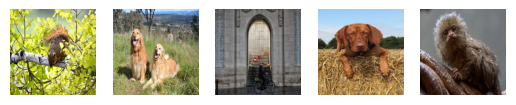

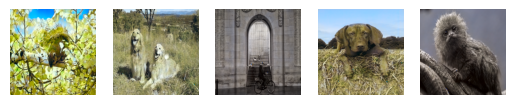

validation Output: 


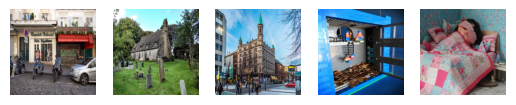

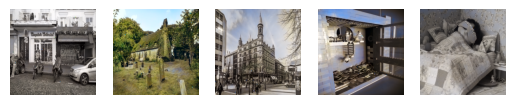


Saved model to ./ResnetBackbone_UNet_Full/UNet_1500.pth.
Train Epoch: 1501 [0/256 (0%)]	UNetLoss: 0.073189
Train Epoch: 1501 [160/256 (62%)]	UNetLoss: 0.087697
Train Epoch: 1502 [0/256 (0%)]	UNetLoss: 0.086791
Train Epoch: 1502 [160/256 (62%)]	UNetLoss: 0.084246
Train Epoch: 1503 [0/256 (0%)]	UNetLoss: 0.094806
Train Epoch: 1503 [160/256 (62%)]	UNetLoss: 0.088636
Train Epoch: 1504 [0/256 (0%)]	UNetLoss: 0.071089
Train Epoch: 1504 [160/256 (62%)]	UNetLoss: 0.090347
Train Epoch: 1505 [0/256 (0%)]	UNetLoss: 0.084246
Train Epoch: 1505 [160/256 (62%)]	UNetLoss: 0.082924
Train Epoch: 1506 [0/256 (0%)]	UNetLoss: 0.097736
Train Epoch: 1506 [160/256 (62%)]	UNetLoss: 0.082029
Train Epoch: 1507 [0/256 (0%)]	UNetLoss: 0.075453
Train Epoch: 1507 [160/256 (62%)]	UNetLoss: 0.073297
Train Epoch: 1508 [0/256 (0%)]	UNetLoss: 0.085951
Train Epoch: 1508 [160/256 (62%)]	UNetLoss: 0.082729
Train Epoch: 1509 [0/256 (0%)]	UNetLoss: 0.075235
Train Epoch: 1509 [160/256 (62%)]	UNetLoss: 0.090062
Train Epoch: 15

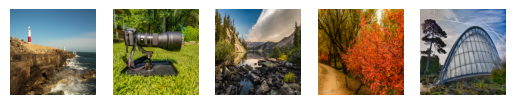

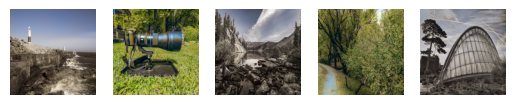

validation Output: 


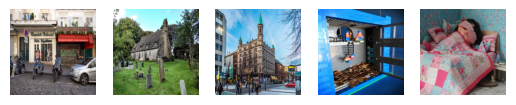

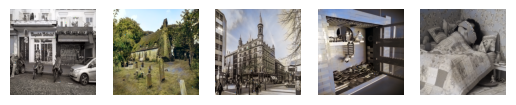


Saved model to ./ResnetBackbone_UNet_Full/UNet_1550.pth.
Train Epoch: 1551 [0/256 (0%)]	UNetLoss: 0.074929
Train Epoch: 1551 [160/256 (62%)]	UNetLoss: 0.078017
Train Epoch: 1552 [0/256 (0%)]	UNetLoss: 0.106456
Train Epoch: 1552 [160/256 (62%)]	UNetLoss: 0.076580
Train Epoch: 1553 [0/256 (0%)]	UNetLoss: 0.086405
Train Epoch: 1553 [160/256 (62%)]	UNetLoss: 0.093930
Train Epoch: 1554 [0/256 (0%)]	UNetLoss: 0.080134
Train Epoch: 1554 [160/256 (62%)]	UNetLoss: 0.076605
Train Epoch: 1555 [0/256 (0%)]	UNetLoss: 0.075982
Train Epoch: 1555 [160/256 (62%)]	UNetLoss: 0.094881
Train Epoch: 1556 [0/256 (0%)]	UNetLoss: 0.090734
Train Epoch: 1556 [160/256 (62%)]	UNetLoss: 0.108763
Train Epoch: 1557 [0/256 (0%)]	UNetLoss: 0.082233
Train Epoch: 1557 [160/256 (62%)]	UNetLoss: 0.096421
Train Epoch: 1558 [0/256 (0%)]	UNetLoss: 0.074397
Train Epoch: 1558 [160/256 (62%)]	UNetLoss: 0.079932
Train Epoch: 1559 [0/256 (0%)]	UNetLoss: 0.068407
Train Epoch: 1559 [160/256 (62%)]	UNetLoss: 0.076782
Train Epoch: 15

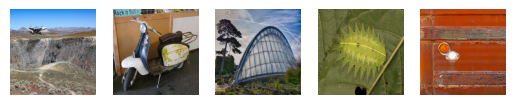

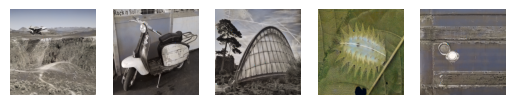

validation Output: 


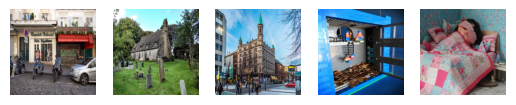

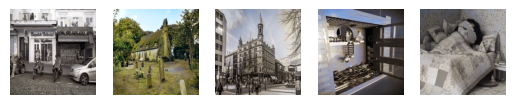


Saved model to ./ResnetBackbone_UNet_Full/UNet_1600.pth.
Train Epoch: 1601 [0/256 (0%)]	UNetLoss: 0.070399
Train Epoch: 1601 [160/256 (62%)]	UNetLoss: 0.078372
Train Epoch: 1602 [0/256 (0%)]	UNetLoss: 0.077355
Train Epoch: 1602 [160/256 (62%)]	UNetLoss: 0.092370
Train Epoch: 1603 [0/256 (0%)]	UNetLoss: 0.096167
Train Epoch: 1603 [160/256 (62%)]	UNetLoss: 0.085932
Train Epoch: 1604 [0/256 (0%)]	UNetLoss: 0.088552
Train Epoch: 1604 [160/256 (62%)]	UNetLoss: 0.091150
Train Epoch: 1605 [0/256 (0%)]	UNetLoss: 0.078055
Train Epoch: 1605 [160/256 (62%)]	UNetLoss: 0.083116
Train Epoch: 1606 [0/256 (0%)]	UNetLoss: 0.080058
Train Epoch: 1606 [160/256 (62%)]	UNetLoss: 0.092365
Train Epoch: 1607 [0/256 (0%)]	UNetLoss: 0.079769
Train Epoch: 1607 [160/256 (62%)]	UNetLoss: 0.099836
Train Epoch: 1608 [0/256 (0%)]	UNetLoss: 0.075378
Train Epoch: 1608 [160/256 (62%)]	UNetLoss: 0.101991
Train Epoch: 1609 [0/256 (0%)]	UNetLoss: 0.060051
Train Epoch: 1609 [160/256 (62%)]	UNetLoss: 0.108185
Train Epoch: 16

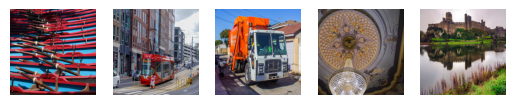

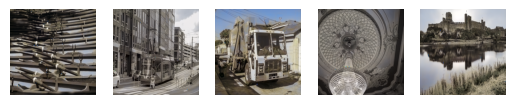

validation Output: 


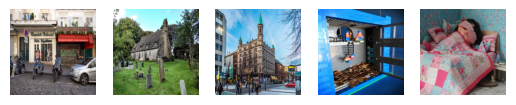

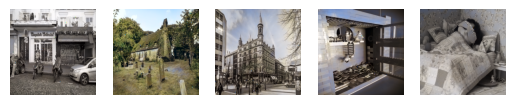


Saved model to ./ResnetBackbone_UNet_Full/UNet_1650.pth.
Train Epoch: 1651 [0/256 (0%)]	UNetLoss: 0.093999
Train Epoch: 1651 [160/256 (62%)]	UNetLoss: 0.064991
Train Epoch: 1652 [0/256 (0%)]	UNetLoss: 0.087883
Train Epoch: 1652 [160/256 (62%)]	UNetLoss: 0.073212
Train Epoch: 1653 [0/256 (0%)]	UNetLoss: 0.075516
Train Epoch: 1653 [160/256 (62%)]	UNetLoss: 0.077528
Train Epoch: 1654 [0/256 (0%)]	UNetLoss: 0.091287
Train Epoch: 1654 [160/256 (62%)]	UNetLoss: 0.073603
Train Epoch: 1655 [0/256 (0%)]	UNetLoss: 0.077090
Train Epoch: 1655 [160/256 (62%)]	UNetLoss: 0.104114
Train Epoch: 1656 [0/256 (0%)]	UNetLoss: 0.098293
Train Epoch: 1656 [160/256 (62%)]	UNetLoss: 0.101469
Train Epoch: 1657 [0/256 (0%)]	UNetLoss: 0.077273
Train Epoch: 1657 [160/256 (62%)]	UNetLoss: 0.090575
Train Epoch: 1658 [0/256 (0%)]	UNetLoss: 0.075966
Train Epoch: 1658 [160/256 (62%)]	UNetLoss: 0.069339
Train Epoch: 1659 [0/256 (0%)]	UNetLoss: 0.059255
Train Epoch: 1659 [160/256 (62%)]	UNetLoss: 0.096083
Train Epoch: 16

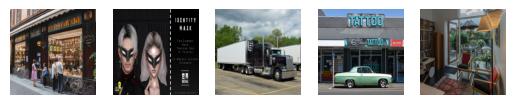

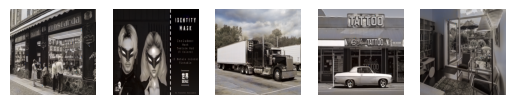

validation Output: 


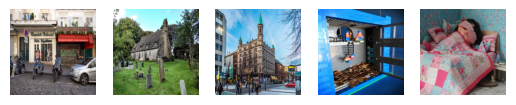

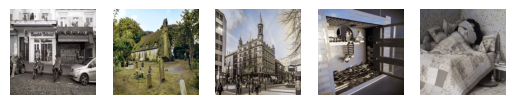


Saved model to ./ResnetBackbone_UNet_Full/UNet_1700.pth.
Train Epoch: 1701 [0/256 (0%)]	UNetLoss: 0.082801
Train Epoch: 1701 [160/256 (62%)]	UNetLoss: 0.082146
Train Epoch: 1702 [0/256 (0%)]	UNetLoss: 0.071594
Train Epoch: 1702 [160/256 (62%)]	UNetLoss: 0.078251
Train Epoch: 1703 [0/256 (0%)]	UNetLoss: 0.084329
Train Epoch: 1703 [160/256 (62%)]	UNetLoss: 0.081850
Train Epoch: 1704 [0/256 (0%)]	UNetLoss: 0.088915
Train Epoch: 1704 [160/256 (62%)]	UNetLoss: 0.085489
Train Epoch: 1705 [0/256 (0%)]	UNetLoss: 0.102522
Train Epoch: 1705 [160/256 (62%)]	UNetLoss: 0.076873
Train Epoch: 1706 [0/256 (0%)]	UNetLoss: 0.103600
Train Epoch: 1706 [160/256 (62%)]	UNetLoss: 0.088784
Train Epoch: 1707 [0/256 (0%)]	UNetLoss: 0.067274
Train Epoch: 1707 [160/256 (62%)]	UNetLoss: 0.103308
Train Epoch: 1708 [0/256 (0%)]	UNetLoss: 0.067784
Train Epoch: 1708 [160/256 (62%)]	UNetLoss: 0.075972
Train Epoch: 1709 [0/256 (0%)]	UNetLoss: 0.093473
Train Epoch: 1709 [160/256 (62%)]	UNetLoss: 0.078045
Train Epoch: 17

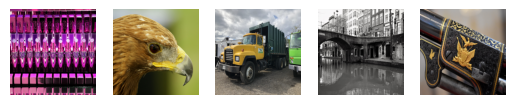

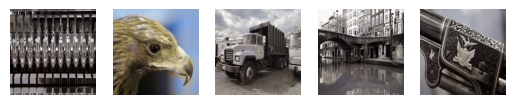

validation Output: 


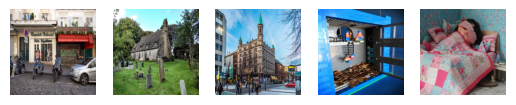

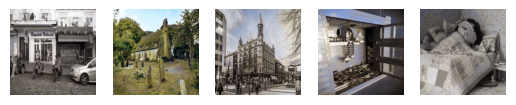


Saved model to ./ResnetBackbone_UNet_Full/UNet_1750.pth.
Train Epoch: 1751 [0/256 (0%)]	UNetLoss: 0.071174
Train Epoch: 1751 [160/256 (62%)]	UNetLoss: 0.085896
Train Epoch: 1752 [0/256 (0%)]	UNetLoss: 0.071634
Train Epoch: 1752 [160/256 (62%)]	UNetLoss: 0.066984
Train Epoch: 1753 [0/256 (0%)]	UNetLoss: 0.089431
Train Epoch: 1753 [160/256 (62%)]	UNetLoss: 0.083242
Train Epoch: 1754 [0/256 (0%)]	UNetLoss: 0.070838
Train Epoch: 1754 [160/256 (62%)]	UNetLoss: 0.075828
Train Epoch: 1755 [0/256 (0%)]	UNetLoss: 0.077887
Train Epoch: 1755 [160/256 (62%)]	UNetLoss: 0.090994
Train Epoch: 1756 [0/256 (0%)]	UNetLoss: 0.079472
Train Epoch: 1756 [160/256 (62%)]	UNetLoss: 0.120816
Train Epoch: 1757 [0/256 (0%)]	UNetLoss: 0.084379
Train Epoch: 1757 [160/256 (62%)]	UNetLoss: 0.073198
Train Epoch: 1758 [0/256 (0%)]	UNetLoss: 0.073791
Train Epoch: 1758 [160/256 (62%)]	UNetLoss: 0.083354
Train Epoch: 1759 [0/256 (0%)]	UNetLoss: 0.081093
Train Epoch: 1759 [160/256 (62%)]	UNetLoss: 0.070195
Train Epoch: 17

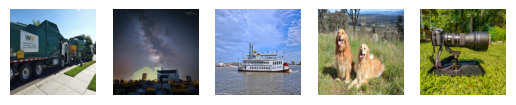

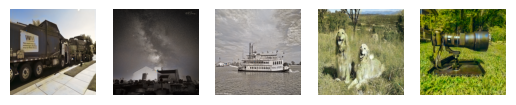

validation Output: 


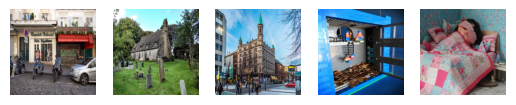

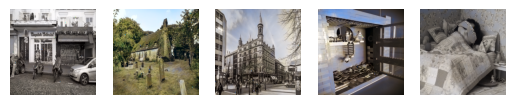


Saved model to ./ResnetBackbone_UNet_Full/UNet_1800.pth.
Train Epoch: 1801 [0/256 (0%)]	UNetLoss: 0.066228
Train Epoch: 1801 [160/256 (62%)]	UNetLoss: 0.084255
Train Epoch: 1802 [0/256 (0%)]	UNetLoss: 0.091540
Train Epoch: 1802 [160/256 (62%)]	UNetLoss: 0.073254
Train Epoch: 1803 [0/256 (0%)]	UNetLoss: 0.090005
Train Epoch: 1803 [160/256 (62%)]	UNetLoss: 0.098725
Train Epoch: 1804 [0/256 (0%)]	UNetLoss: 0.083644
Train Epoch: 1804 [160/256 (62%)]	UNetLoss: 0.102817
Train Epoch: 1805 [0/256 (0%)]	UNetLoss: 0.080236
Train Epoch: 1805 [160/256 (62%)]	UNetLoss: 0.108875
Train Epoch: 1806 [0/256 (0%)]	UNetLoss: 0.087320
Train Epoch: 1806 [160/256 (62%)]	UNetLoss: 0.092381
Train Epoch: 1807 [0/256 (0%)]	UNetLoss: 0.090954
Train Epoch: 1807 [160/256 (62%)]	UNetLoss: 0.105083
Train Epoch: 1808 [0/256 (0%)]	UNetLoss: 0.067901
Train Epoch: 1808 [160/256 (62%)]	UNetLoss: 0.088940
Train Epoch: 1809 [0/256 (0%)]	UNetLoss: 0.092456
Train Epoch: 1809 [160/256 (62%)]	UNetLoss: 0.080873
Train Epoch: 18

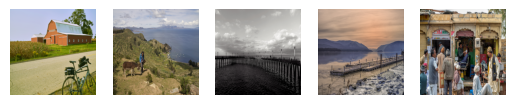

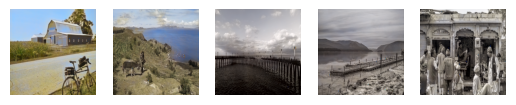

validation Output: 


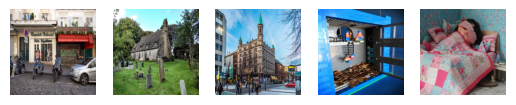

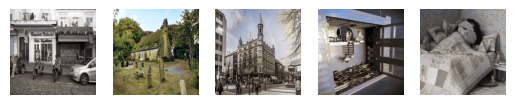


Saved model to ./ResnetBackbone_UNet_Full/UNet_1850.pth.
Train Epoch: 1851 [0/256 (0%)]	UNetLoss: 0.069747
Train Epoch: 1851 [160/256 (62%)]	UNetLoss: 0.090465
Train Epoch: 1852 [0/256 (0%)]	UNetLoss: 0.080116
Train Epoch: 1852 [160/256 (62%)]	UNetLoss: 0.086670
Train Epoch: 1853 [0/256 (0%)]	UNetLoss: 0.072904
Train Epoch: 1853 [160/256 (62%)]	UNetLoss: 0.076868
Train Epoch: 1854 [0/256 (0%)]	UNetLoss: 0.079552
Train Epoch: 1854 [160/256 (62%)]	UNetLoss: 0.091817
Train Epoch: 1855 [0/256 (0%)]	UNetLoss: 0.083019
Train Epoch: 1855 [160/256 (62%)]	UNetLoss: 0.084084
Train Epoch: 1856 [0/256 (0%)]	UNetLoss: 0.082026
Train Epoch: 1856 [160/256 (62%)]	UNetLoss: 0.100859
Train Epoch: 1857 [0/256 (0%)]	UNetLoss: 0.083649
Train Epoch: 1857 [160/256 (62%)]	UNetLoss: 0.081247
Train Epoch: 1858 [0/256 (0%)]	UNetLoss: 0.072270
Train Epoch: 1858 [160/256 (62%)]	UNetLoss: 0.102172
Train Epoch: 1859 [0/256 (0%)]	UNetLoss: 0.098180
Train Epoch: 1859 [160/256 (62%)]	UNetLoss: 0.073936
Train Epoch: 18

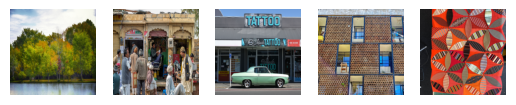

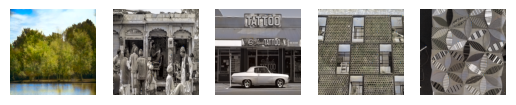

validation Output: 


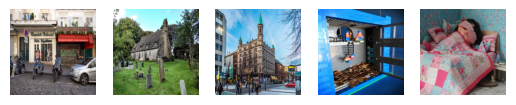

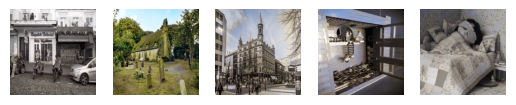


Saved model to ./ResnetBackbone_UNet_Full/UNet_1900.pth.
Train Epoch: 1901 [0/256 (0%)]	UNetLoss: 0.075834
Train Epoch: 1901 [160/256 (62%)]	UNetLoss: 0.089432
Train Epoch: 1902 [0/256 (0%)]	UNetLoss: 0.089900
Train Epoch: 1902 [160/256 (62%)]	UNetLoss: 0.083140
Train Epoch: 1903 [0/256 (0%)]	UNetLoss: 0.074196
Train Epoch: 1903 [160/256 (62%)]	UNetLoss: 0.081937
Train Epoch: 1904 [0/256 (0%)]	UNetLoss: 0.081795
Train Epoch: 1904 [160/256 (62%)]	UNetLoss: 0.075625
Train Epoch: 1905 [0/256 (0%)]	UNetLoss: 0.075627
Train Epoch: 1905 [160/256 (62%)]	UNetLoss: 0.073465
Train Epoch: 1906 [0/256 (0%)]	UNetLoss: 0.059923
Train Epoch: 1906 [160/256 (62%)]	UNetLoss: 0.094593
Train Epoch: 1907 [0/256 (0%)]	UNetLoss: 0.083871
Train Epoch: 1907 [160/256 (62%)]	UNetLoss: 0.062324
Train Epoch: 1908 [0/256 (0%)]	UNetLoss: 0.087981
Train Epoch: 1908 [160/256 (62%)]	UNetLoss: 0.093625
Train Epoch: 1909 [0/256 (0%)]	UNetLoss: 0.082719
Train Epoch: 1909 [160/256 (62%)]	UNetLoss: 0.090864
Train Epoch: 19

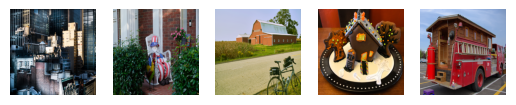

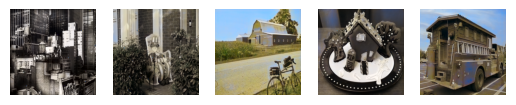

validation Output: 


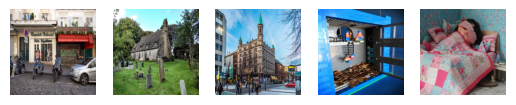

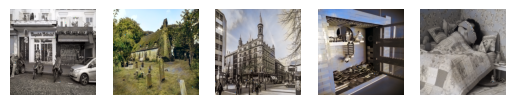


Saved model to ./ResnetBackbone_UNet_Full/UNet_1950.pth.
Train Epoch: 1951 [0/256 (0%)]	UNetLoss: 0.086680
Train Epoch: 1951 [160/256 (62%)]	UNetLoss: 0.101324
Train Epoch: 1952 [0/256 (0%)]	UNetLoss: 0.095087
Train Epoch: 1952 [160/256 (62%)]	UNetLoss: 0.076096
Train Epoch: 1953 [0/256 (0%)]	UNetLoss: 0.084902
Train Epoch: 1953 [160/256 (62%)]	UNetLoss: 0.090168
Train Epoch: 1954 [0/256 (0%)]	UNetLoss: 0.085420
Train Epoch: 1954 [160/256 (62%)]	UNetLoss: 0.092194
Train Epoch: 1955 [0/256 (0%)]	UNetLoss: 0.069149
Train Epoch: 1955 [160/256 (62%)]	UNetLoss: 0.074438
Train Epoch: 1956 [0/256 (0%)]	UNetLoss: 0.099321
Train Epoch: 1956 [160/256 (62%)]	UNetLoss: 0.069786
Train Epoch: 1957 [0/256 (0%)]	UNetLoss: 0.078848
Train Epoch: 1957 [160/256 (62%)]	UNetLoss: 0.093730
Train Epoch: 1958 [0/256 (0%)]	UNetLoss: 0.085838
Train Epoch: 1958 [160/256 (62%)]	UNetLoss: 0.080591
Train Epoch: 1959 [0/256 (0%)]	UNetLoss: 0.071965
Train Epoch: 1959 [160/256 (62%)]	UNetLoss: 0.085304
Train Epoch: 19

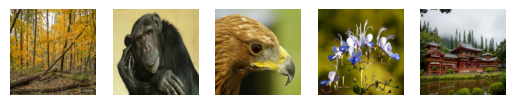

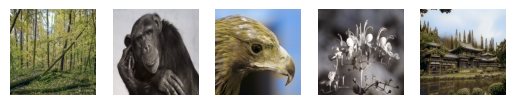

validation Output: 


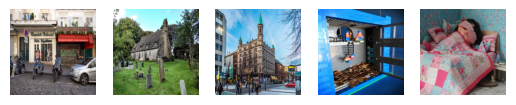

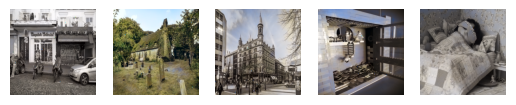


Saved model to ./ResnetBackbone_UNet_Full/UNet_2000.pth.
Train Epoch: 2001 [0/256 (0%)]	UNetLoss: 0.097348
Train Epoch: 2001 [160/256 (62%)]	UNetLoss: 0.098230
Train Epoch: 2002 [0/256 (0%)]	UNetLoss: 0.089747
Train Epoch: 2002 [160/256 (62%)]	UNetLoss: 0.096278
Train Epoch: 2003 [0/256 (0%)]	UNetLoss: 0.079762
Train Epoch: 2003 [160/256 (62%)]	UNetLoss: 0.084555
Train Epoch: 2004 [0/256 (0%)]	UNetLoss: 0.073771
Train Epoch: 2004 [160/256 (62%)]	UNetLoss: 0.075575
Train Epoch: 2005 [0/256 (0%)]	UNetLoss: 0.075778
Train Epoch: 2005 [160/256 (62%)]	UNetLoss: 0.064099
Train Epoch: 2006 [0/256 (0%)]	UNetLoss: 0.065214
Train Epoch: 2006 [160/256 (62%)]	UNetLoss: 0.090525
Train Epoch: 2007 [0/256 (0%)]	UNetLoss: 0.101643
Train Epoch: 2007 [160/256 (62%)]	UNetLoss: 0.101292
Train Epoch: 2008 [0/256 (0%)]	UNetLoss: 0.078350
Train Epoch: 2008 [160/256 (62%)]	UNetLoss: 0.096206
Train Epoch: 2009 [0/256 (0%)]	UNetLoss: 0.082014
Train Epoch: 2009 [160/256 (62%)]	UNetLoss: 0.070586
Train Epoch: 20

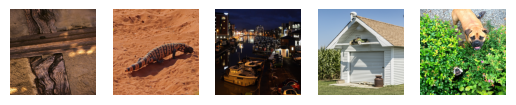

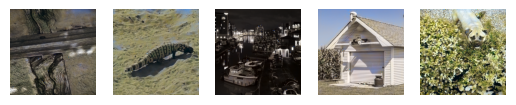

validation Output: 


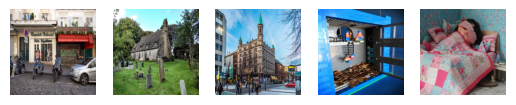

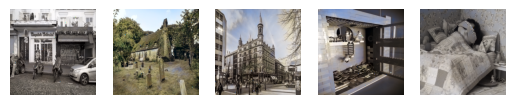


Saved model to ./ResnetBackbone_UNet_Full/UNet_2050.pth.
Train Epoch: 2051 [0/256 (0%)]	UNetLoss: 0.091135
Train Epoch: 2051 [160/256 (62%)]	UNetLoss: 0.085137
Train Epoch: 2052 [0/256 (0%)]	UNetLoss: 0.075221
Train Epoch: 2052 [160/256 (62%)]	UNetLoss: 0.088383
Train Epoch: 2053 [0/256 (0%)]	UNetLoss: 0.076434
Train Epoch: 2053 [160/256 (62%)]	UNetLoss: 0.084514
Train Epoch: 2054 [0/256 (0%)]	UNetLoss: 0.072851
Train Epoch: 2054 [160/256 (62%)]	UNetLoss: 0.067958
Train Epoch: 2055 [0/256 (0%)]	UNetLoss: 0.105773
Train Epoch: 2055 [160/256 (62%)]	UNetLoss: 0.071071
Train Epoch: 2056 [0/256 (0%)]	UNetLoss: 0.065670
Train Epoch: 2056 [160/256 (62%)]	UNetLoss: 0.090631
Train Epoch: 2057 [0/256 (0%)]	UNetLoss: 0.084497
Train Epoch: 2057 [160/256 (62%)]	UNetLoss: 0.081081
Train Epoch: 2058 [0/256 (0%)]	UNetLoss: 0.104506
Train Epoch: 2058 [160/256 (62%)]	UNetLoss: 0.076139
Train Epoch: 2059 [0/256 (0%)]	UNetLoss: 0.110123
Train Epoch: 2059 [160/256 (62%)]	UNetLoss: 0.077763
Train Epoch: 20

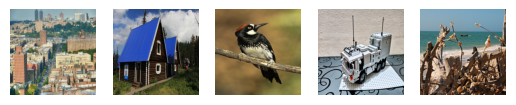

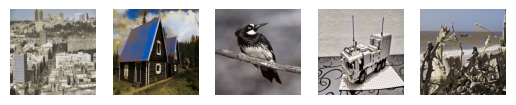

validation Output: 


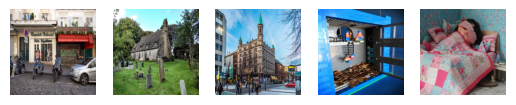

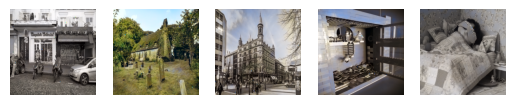


Saved model to ./ResnetBackbone_UNet_Full/UNet_2100.pth.
Train Epoch: 2101 [0/256 (0%)]	UNetLoss: 0.099432
Train Epoch: 2101 [160/256 (62%)]	UNetLoss: 0.094864
Train Epoch: 2102 [0/256 (0%)]	UNetLoss: 0.091525
Train Epoch: 2102 [160/256 (62%)]	UNetLoss: 0.074302
Train Epoch: 2103 [0/256 (0%)]	UNetLoss: 0.109509
Train Epoch: 2103 [160/256 (62%)]	UNetLoss: 0.084329
Train Epoch: 2104 [0/256 (0%)]	UNetLoss: 0.075161
Train Epoch: 2104 [160/256 (62%)]	UNetLoss: 0.090133
Train Epoch: 2105 [0/256 (0%)]	UNetLoss: 0.083553
Train Epoch: 2105 [160/256 (62%)]	UNetLoss: 0.090416
Train Epoch: 2106 [0/256 (0%)]	UNetLoss: 0.079512
Train Epoch: 2106 [160/256 (62%)]	UNetLoss: 0.080290
Train Epoch: 2107 [0/256 (0%)]	UNetLoss: 0.076069
Train Epoch: 2107 [160/256 (62%)]	UNetLoss: 0.065794
Train Epoch: 2108 [0/256 (0%)]	UNetLoss: 0.078629
Train Epoch: 2108 [160/256 (62%)]	UNetLoss: 0.053065
Train Epoch: 2109 [0/256 (0%)]	UNetLoss: 0.087825
Train Epoch: 2109 [160/256 (62%)]	UNetLoss: 0.074431
Train Epoch: 21

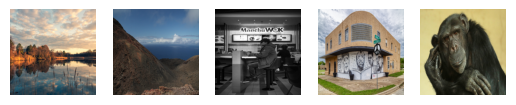

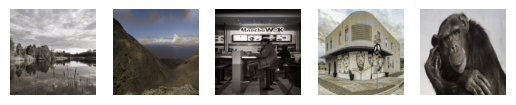

validation Output: 


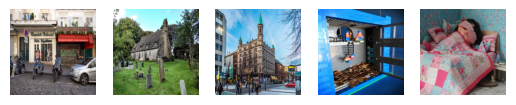

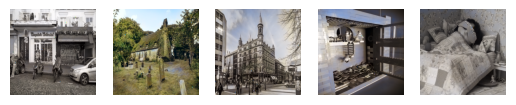


Saved model to ./ResnetBackbone_UNet_Full/UNet_2150.pth.
Train Epoch: 2151 [0/256 (0%)]	UNetLoss: 0.083078
Train Epoch: 2151 [160/256 (62%)]	UNetLoss: 0.074195
Train Epoch: 2152 [0/256 (0%)]	UNetLoss: 0.080703
Train Epoch: 2152 [160/256 (62%)]	UNetLoss: 0.073534
Train Epoch: 2153 [0/256 (0%)]	UNetLoss: 0.066446
Train Epoch: 2153 [160/256 (62%)]	UNetLoss: 0.088868
Train Epoch: 2154 [0/256 (0%)]	UNetLoss: 0.094332
Train Epoch: 2154 [160/256 (62%)]	UNetLoss: 0.084252
Train Epoch: 2155 [0/256 (0%)]	UNetLoss: 0.075145
Train Epoch: 2155 [160/256 (62%)]	UNetLoss: 0.076667
Train Epoch: 2156 [0/256 (0%)]	UNetLoss: 0.106983
Train Epoch: 2156 [160/256 (62%)]	UNetLoss: 0.098641
Train Epoch: 2157 [0/256 (0%)]	UNetLoss: 0.091521
Train Epoch: 2157 [160/256 (62%)]	UNetLoss: 0.096804
Train Epoch: 2158 [0/256 (0%)]	UNetLoss: 0.088490
Train Epoch: 2158 [160/256 (62%)]	UNetLoss: 0.081199
Train Epoch: 2159 [0/256 (0%)]	UNetLoss: 0.080329
Train Epoch: 2159 [160/256 (62%)]	UNetLoss: 0.091784
Train Epoch: 21

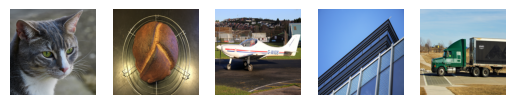

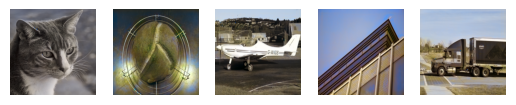

validation Output: 


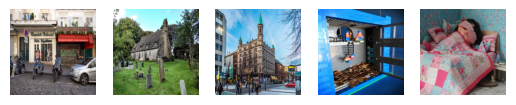

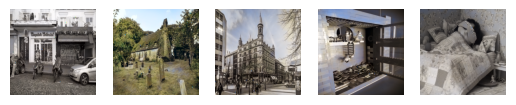


Saved model to ./ResnetBackbone_UNet_Full/UNet_2200.pth.
Train Epoch: 2201 [0/256 (0%)]	UNetLoss: 0.075464
Train Epoch: 2201 [160/256 (62%)]	UNetLoss: 0.093860
Train Epoch: 2202 [0/256 (0%)]	UNetLoss: 0.078835
Train Epoch: 2202 [160/256 (62%)]	UNetLoss: 0.084274
Train Epoch: 2203 [0/256 (0%)]	UNetLoss: 0.094729
Train Epoch: 2203 [160/256 (62%)]	UNetLoss: 0.085965
Train Epoch: 2204 [0/256 (0%)]	UNetLoss: 0.080907
Train Epoch: 2204 [160/256 (62%)]	UNetLoss: 0.083543
Train Epoch: 2205 [0/256 (0%)]	UNetLoss: 0.089123
Train Epoch: 2205 [160/256 (62%)]	UNetLoss: 0.077292
Train Epoch: 2206 [0/256 (0%)]	UNetLoss: 0.063082
Train Epoch: 2206 [160/256 (62%)]	UNetLoss: 0.066441
Train Epoch: 2207 [0/256 (0%)]	UNetLoss: 0.086766
Train Epoch: 2207 [160/256 (62%)]	UNetLoss: 0.072377
Train Epoch: 2208 [0/256 (0%)]	UNetLoss: 0.087263
Train Epoch: 2208 [160/256 (62%)]	UNetLoss: 0.095974
Train Epoch: 2209 [0/256 (0%)]	UNetLoss: 0.083244
Train Epoch: 2209 [160/256 (62%)]	UNetLoss: 0.084421
Train Epoch: 22

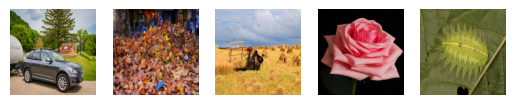

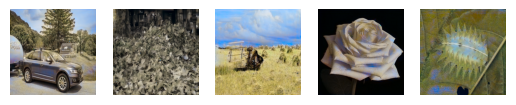

validation Output: 


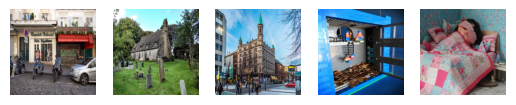

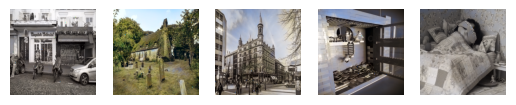


Saved model to ./ResnetBackbone_UNet_Full/UNet_2250.pth.
Train Epoch: 2251 [0/256 (0%)]	UNetLoss: 0.105616
Train Epoch: 2251 [160/256 (62%)]	UNetLoss: 0.061240
Train Epoch: 2252 [0/256 (0%)]	UNetLoss: 0.060830
Train Epoch: 2252 [160/256 (62%)]	UNetLoss: 0.094044
Train Epoch: 2253 [0/256 (0%)]	UNetLoss: 0.081898
Train Epoch: 2253 [160/256 (62%)]	UNetLoss: 0.061031
Train Epoch: 2254 [0/256 (0%)]	UNetLoss: 0.088057
Train Epoch: 2254 [160/256 (62%)]	UNetLoss: 0.063359
Train Epoch: 2255 [0/256 (0%)]	UNetLoss: 0.094158
Train Epoch: 2255 [160/256 (62%)]	UNetLoss: 0.069803
Train Epoch: 2256 [0/256 (0%)]	UNetLoss: 0.088772
Train Epoch: 2256 [160/256 (62%)]	UNetLoss: 0.081654
Train Epoch: 2257 [0/256 (0%)]	UNetLoss: 0.072628
Train Epoch: 2257 [160/256 (62%)]	UNetLoss: 0.095665
Train Epoch: 2258 [0/256 (0%)]	UNetLoss: 0.083456
Train Epoch: 2258 [160/256 (62%)]	UNetLoss: 0.082592
Train Epoch: 2259 [0/256 (0%)]	UNetLoss: 0.097760
Train Epoch: 2259 [160/256 (62%)]	UNetLoss: 0.084965
Train Epoch: 22

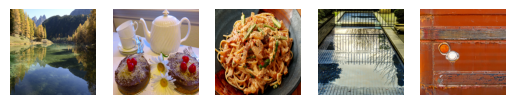

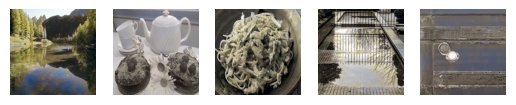

validation Output: 


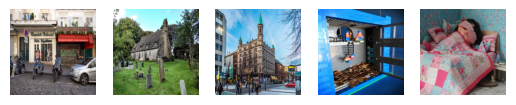

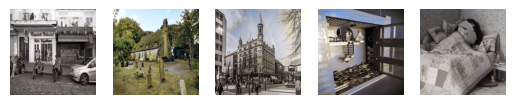


Saved model to ./ResnetBackbone_UNet_Full/UNet_2300.pth.
Train Epoch: 2301 [0/256 (0%)]	UNetLoss: 0.112186
Train Epoch: 2301 [160/256 (62%)]	UNetLoss: 0.075726
Train Epoch: 2302 [0/256 (0%)]	UNetLoss: 0.088028
Train Epoch: 2302 [160/256 (62%)]	UNetLoss: 0.088505
Train Epoch: 2303 [0/256 (0%)]	UNetLoss: 0.061886
Train Epoch: 2303 [160/256 (62%)]	UNetLoss: 0.098685
Train Epoch: 2304 [0/256 (0%)]	UNetLoss: 0.080491
Train Epoch: 2304 [160/256 (62%)]	UNetLoss: 0.083548
Train Epoch: 2305 [0/256 (0%)]	UNetLoss: 0.103785
Train Epoch: 2305 [160/256 (62%)]	UNetLoss: 0.106294
Train Epoch: 2306 [0/256 (0%)]	UNetLoss: 0.084762
Train Epoch: 2306 [160/256 (62%)]	UNetLoss: 0.095650
Train Epoch: 2307 [0/256 (0%)]	UNetLoss: 0.092458
Train Epoch: 2307 [160/256 (62%)]	UNetLoss: 0.071495
Train Epoch: 2308 [0/256 (0%)]	UNetLoss: 0.068289
Train Epoch: 2308 [160/256 (62%)]	UNetLoss: 0.078351
Train Epoch: 2309 [0/256 (0%)]	UNetLoss: 0.106309
Train Epoch: 2309 [160/256 (62%)]	UNetLoss: 0.082250
Train Epoch: 23

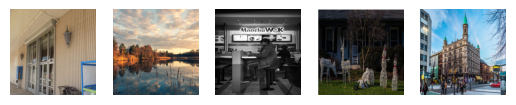

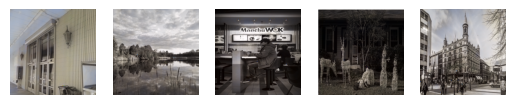

validation Output: 


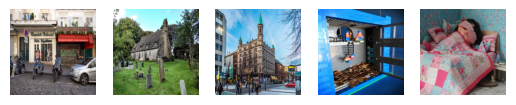

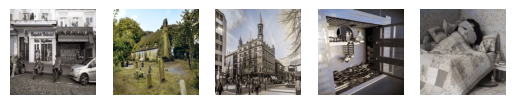


Saved model to ./ResnetBackbone_UNet_Full/UNet_2350.pth.
Train Epoch: 2351 [0/256 (0%)]	UNetLoss: 0.096518
Train Epoch: 2351 [160/256 (62%)]	UNetLoss: 0.066321
Train Epoch: 2352 [0/256 (0%)]	UNetLoss: 0.086145
Train Epoch: 2352 [160/256 (62%)]	UNetLoss: 0.077424
Train Epoch: 2353 [0/256 (0%)]	UNetLoss: 0.089927
Train Epoch: 2353 [160/256 (62%)]	UNetLoss: 0.068504
Train Epoch: 2354 [0/256 (0%)]	UNetLoss: 0.064235
Train Epoch: 2354 [160/256 (62%)]	UNetLoss: 0.090115
Train Epoch: 2355 [0/256 (0%)]	UNetLoss: 0.071861
Train Epoch: 2355 [160/256 (62%)]	UNetLoss: 0.078704
Train Epoch: 2356 [0/256 (0%)]	UNetLoss: 0.082128
Train Epoch: 2356 [160/256 (62%)]	UNetLoss: 0.072023
Train Epoch: 2357 [0/256 (0%)]	UNetLoss: 0.095045
Train Epoch: 2357 [160/256 (62%)]	UNetLoss: 0.084158
Train Epoch: 2358 [0/256 (0%)]	UNetLoss: 0.100517
Train Epoch: 2358 [160/256 (62%)]	UNetLoss: 0.087956
Train Epoch: 2359 [0/256 (0%)]	UNetLoss: 0.094259
Train Epoch: 2359 [160/256 (62%)]	UNetLoss: 0.084601
Train Epoch: 23

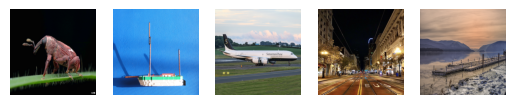

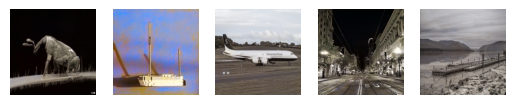

validation Output: 


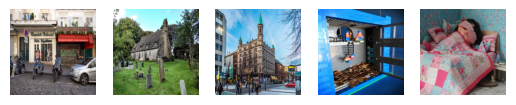

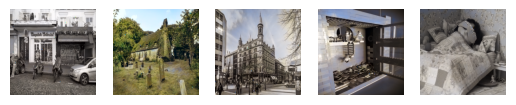


Saved model to ./ResnetBackbone_UNet_Full/UNet_2400.pth.
Train Epoch: 2401 [0/256 (0%)]	UNetLoss: 0.096717
Train Epoch: 2401 [160/256 (62%)]	UNetLoss: 0.079398
Train Epoch: 2402 [0/256 (0%)]	UNetLoss: 0.085238
Train Epoch: 2402 [160/256 (62%)]	UNetLoss: 0.067165
Train Epoch: 2403 [0/256 (0%)]	UNetLoss: 0.083446
Train Epoch: 2403 [160/256 (62%)]	UNetLoss: 0.095115
Train Epoch: 2404 [0/256 (0%)]	UNetLoss: 0.077200
Train Epoch: 2404 [160/256 (62%)]	UNetLoss: 0.086008
Train Epoch: 2405 [0/256 (0%)]	UNetLoss: 0.083475
Train Epoch: 2405 [160/256 (62%)]	UNetLoss: 0.084030
Train Epoch: 2406 [0/256 (0%)]	UNetLoss: 0.073808
Train Epoch: 2406 [160/256 (62%)]	UNetLoss: 0.091435
Train Epoch: 2407 [0/256 (0%)]	UNetLoss: 0.083312
Train Epoch: 2407 [160/256 (62%)]	UNetLoss: 0.083263
Train Epoch: 2408 [0/256 (0%)]	UNetLoss: 0.080581
Train Epoch: 2408 [160/256 (62%)]	UNetLoss: 0.081634
Train Epoch: 2409 [0/256 (0%)]	UNetLoss: 0.090773
Train Epoch: 2409 [160/256 (62%)]	UNetLoss: 0.078834
Train Epoch: 24

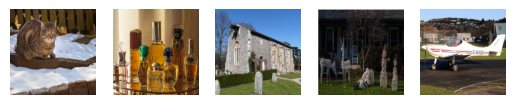

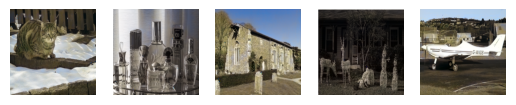

validation Output: 


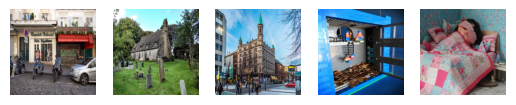

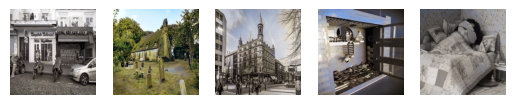


Saved model to ./ResnetBackbone_UNet_Full/UNet_2450.pth.
Train Epoch: 2451 [0/256 (0%)]	UNetLoss: 0.082786
Train Epoch: 2451 [160/256 (62%)]	UNetLoss: 0.080962
Train Epoch: 2452 [0/256 (0%)]	UNetLoss: 0.080284
Train Epoch: 2452 [160/256 (62%)]	UNetLoss: 0.065421
Train Epoch: 2453 [0/256 (0%)]	UNetLoss: 0.085184
Train Epoch: 2453 [160/256 (62%)]	UNetLoss: 0.089149
Train Epoch: 2454 [0/256 (0%)]	UNetLoss: 0.068188
Train Epoch: 2454 [160/256 (62%)]	UNetLoss: 0.087366
Train Epoch: 2455 [0/256 (0%)]	UNetLoss: 0.086326
Train Epoch: 2455 [160/256 (62%)]	UNetLoss: 0.069536
Train Epoch: 2456 [0/256 (0%)]	UNetLoss: 0.087195
Train Epoch: 2456 [160/256 (62%)]	UNetLoss: 0.063555
Train Epoch: 2457 [0/256 (0%)]	UNetLoss: 0.068693
Train Epoch: 2457 [160/256 (62%)]	UNetLoss: 0.105710
Train Epoch: 2458 [0/256 (0%)]	UNetLoss: 0.077809
Train Epoch: 2458 [160/256 (62%)]	UNetLoss: 0.082078
Train Epoch: 2459 [0/256 (0%)]	UNetLoss: 0.104440
Train Epoch: 2459 [160/256 (62%)]	UNetLoss: 0.092790
Train Epoch: 24

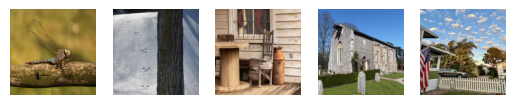

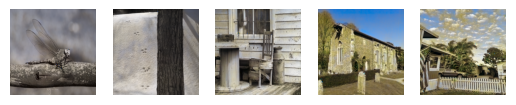

validation Output: 


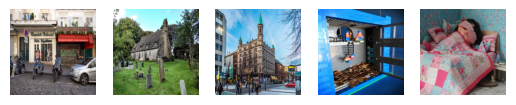

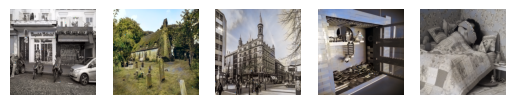


Saved model to ./ResnetBackbone_UNet_Full/UNet_2500.pth.
Train Epoch: 2501 [0/256 (0%)]	UNetLoss: 0.100393
Train Epoch: 2501 [160/256 (62%)]	UNetLoss: 0.071605
Train Epoch: 2502 [0/256 (0%)]	UNetLoss: 0.096830
Train Epoch: 2502 [160/256 (62%)]	UNetLoss: 0.086357
Train Epoch: 2503 [0/256 (0%)]	UNetLoss: 0.090398
Train Epoch: 2503 [160/256 (62%)]	UNetLoss: 0.095803
Train Epoch: 2504 [0/256 (0%)]	UNetLoss: 0.073361
Train Epoch: 2504 [160/256 (62%)]	UNetLoss: 0.090170
Train Epoch: 2505 [0/256 (0%)]	UNetLoss: 0.079598
Train Epoch: 2505 [160/256 (62%)]	UNetLoss: 0.072226
Train Epoch: 2506 [0/256 (0%)]	UNetLoss: 0.107260
Train Epoch: 2506 [160/256 (62%)]	UNetLoss: 0.086304
Train Epoch: 2507 [0/256 (0%)]	UNetLoss: 0.077263
Train Epoch: 2507 [160/256 (62%)]	UNetLoss: 0.087631
Train Epoch: 2508 [0/256 (0%)]	UNetLoss: 0.093129
Train Epoch: 2508 [160/256 (62%)]	UNetLoss: 0.079675
Train Epoch: 2509 [0/256 (0%)]	UNetLoss: 0.084356
Train Epoch: 2509 [160/256 (62%)]	UNetLoss: 0.067576
Train Epoch: 25

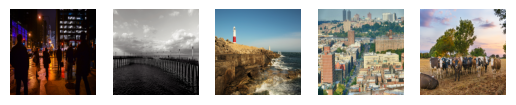

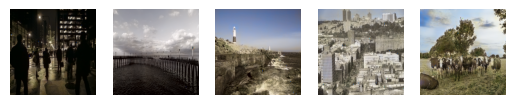

validation Output: 


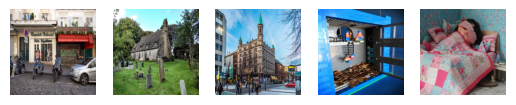

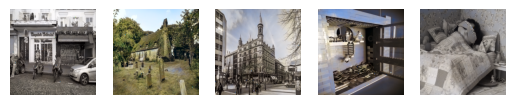


Saved model to ./ResnetBackbone_UNet_Full/UNet_2550.pth.
Train Epoch: 2551 [0/256 (0%)]	UNetLoss: 0.072861
Train Epoch: 2551 [160/256 (62%)]	UNetLoss: 0.077829
Train Epoch: 2552 [0/256 (0%)]	UNetLoss: 0.073805
Train Epoch: 2552 [160/256 (62%)]	UNetLoss: 0.075197
Train Epoch: 2553 [0/256 (0%)]	UNetLoss: 0.088808
Train Epoch: 2553 [160/256 (62%)]	UNetLoss: 0.076017
Train Epoch: 2554 [0/256 (0%)]	UNetLoss: 0.087345
Train Epoch: 2554 [160/256 (62%)]	UNetLoss: 0.094786
Train Epoch: 2555 [0/256 (0%)]	UNetLoss: 0.088066
Train Epoch: 2555 [160/256 (62%)]	UNetLoss: 0.060940
Train Epoch: 2556 [0/256 (0%)]	UNetLoss: 0.083418
Train Epoch: 2556 [160/256 (62%)]	UNetLoss: 0.085333
Train Epoch: 2557 [0/256 (0%)]	UNetLoss: 0.091130
Train Epoch: 2557 [160/256 (62%)]	UNetLoss: 0.077505
Train Epoch: 2558 [0/256 (0%)]	UNetLoss: 0.074443
Train Epoch: 2558 [160/256 (62%)]	UNetLoss: 0.072716
Train Epoch: 2559 [0/256 (0%)]	UNetLoss: 0.092975
Train Epoch: 2559 [160/256 (62%)]	UNetLoss: 0.098176
Train Epoch: 25

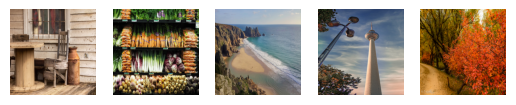

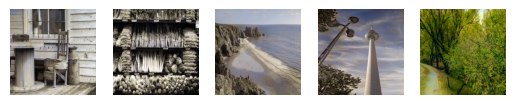

validation Output: 


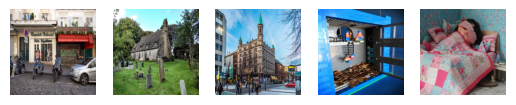

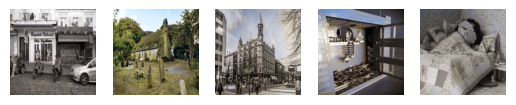


Saved model to ./ResnetBackbone_UNet_Full/UNet_2600.pth.
Train Epoch: 2601 [0/256 (0%)]	UNetLoss: 0.071946
Train Epoch: 2601 [160/256 (62%)]	UNetLoss: 0.088506
Train Epoch: 2602 [0/256 (0%)]	UNetLoss: 0.068625
Train Epoch: 2602 [160/256 (62%)]	UNetLoss: 0.083793
Train Epoch: 2603 [0/256 (0%)]	UNetLoss: 0.087483
Train Epoch: 2603 [160/256 (62%)]	UNetLoss: 0.108638
Train Epoch: 2604 [0/256 (0%)]	UNetLoss: 0.100893
Train Epoch: 2604 [160/256 (62%)]	UNetLoss: 0.083263
Train Epoch: 2605 [0/256 (0%)]	UNetLoss: 0.083480
Train Epoch: 2605 [160/256 (62%)]	UNetLoss: 0.093710
Train Epoch: 2606 [0/256 (0%)]	UNetLoss: 0.065848
Train Epoch: 2606 [160/256 (62%)]	UNetLoss: 0.073044
Train Epoch: 2607 [0/256 (0%)]	UNetLoss: 0.094861
Train Epoch: 2607 [160/256 (62%)]	UNetLoss: 0.079872
Train Epoch: 2608 [0/256 (0%)]	UNetLoss: 0.089535
Train Epoch: 2608 [160/256 (62%)]	UNetLoss: 0.087421
Train Epoch: 2609 [0/256 (0%)]	UNetLoss: 0.092874
Train Epoch: 2609 [160/256 (62%)]	UNetLoss: 0.081450
Train Epoch: 26

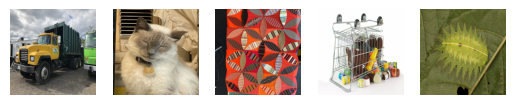

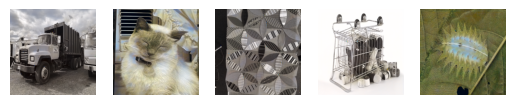

validation Output: 


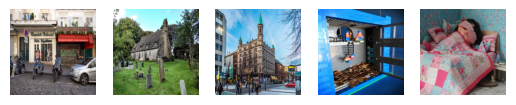

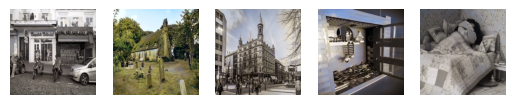


Saved model to ./ResnetBackbone_UNet_Full/UNet_2650.pth.
Train Epoch: 2651 [0/256 (0%)]	UNetLoss: 0.105249
Train Epoch: 2651 [160/256 (62%)]	UNetLoss: 0.069378
Train Epoch: 2652 [0/256 (0%)]	UNetLoss: 0.066169
Train Epoch: 2652 [160/256 (62%)]	UNetLoss: 0.087832
Train Epoch: 2653 [0/256 (0%)]	UNetLoss: 0.093870
Train Epoch: 2653 [160/256 (62%)]	UNetLoss: 0.092593
Train Epoch: 2654 [0/256 (0%)]	UNetLoss: 0.087925
Train Epoch: 2654 [160/256 (62%)]	UNetLoss: 0.079394
Train Epoch: 2655 [0/256 (0%)]	UNetLoss: 0.090224
Train Epoch: 2655 [160/256 (62%)]	UNetLoss: 0.092567
Train Epoch: 2656 [0/256 (0%)]	UNetLoss: 0.094449
Train Epoch: 2656 [160/256 (62%)]	UNetLoss: 0.100409
Train Epoch: 2657 [0/256 (0%)]	UNetLoss: 0.096010
Train Epoch: 2657 [160/256 (62%)]	UNetLoss: 0.090604
Train Epoch: 2658 [0/256 (0%)]	UNetLoss: 0.083945
Train Epoch: 2658 [160/256 (62%)]	UNetLoss: 0.088190
Train Epoch: 2659 [0/256 (0%)]	UNetLoss: 0.086486
Train Epoch: 2659 [160/256 (62%)]	UNetLoss: 0.112894
Train Epoch: 26

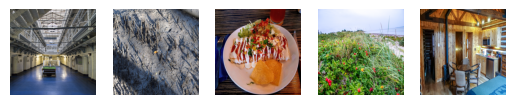

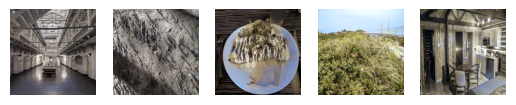

validation Output: 


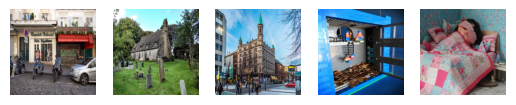

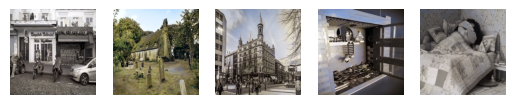


Saved model to ./ResnetBackbone_UNet_Full/UNet_2700.pth.
Train Epoch: 2701 [0/256 (0%)]	UNetLoss: 0.092023
Train Epoch: 2701 [160/256 (62%)]	UNetLoss: 0.076532
Train Epoch: 2702 [0/256 (0%)]	UNetLoss: 0.076416
Train Epoch: 2702 [160/256 (62%)]	UNetLoss: 0.066914
Train Epoch: 2703 [0/256 (0%)]	UNetLoss: 0.092982
Train Epoch: 2703 [160/256 (62%)]	UNetLoss: 0.092579
Train Epoch: 2704 [0/256 (0%)]	UNetLoss: 0.081957
Train Epoch: 2704 [160/256 (62%)]	UNetLoss: 0.083382
Train Epoch: 2705 [0/256 (0%)]	UNetLoss: 0.088143
Train Epoch: 2705 [160/256 (62%)]	UNetLoss: 0.092700
Train Epoch: 2706 [0/256 (0%)]	UNetLoss: 0.077846
Train Epoch: 2706 [160/256 (62%)]	UNetLoss: 0.073420
Train Epoch: 2707 [0/256 (0%)]	UNetLoss: 0.093625
Train Epoch: 2707 [160/256 (62%)]	UNetLoss: 0.072380
Train Epoch: 2708 [0/256 (0%)]	UNetLoss: 0.103327
Train Epoch: 2708 [160/256 (62%)]	UNetLoss: 0.073898
Train Epoch: 2709 [0/256 (0%)]	UNetLoss: 0.103765
Train Epoch: 2709 [160/256 (62%)]	UNetLoss: 0.064223
Train Epoch: 27

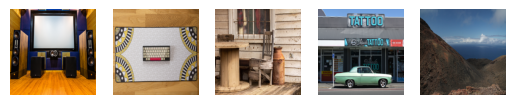

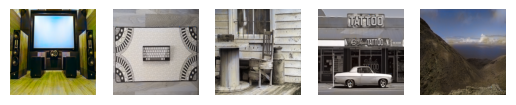

validation Output: 


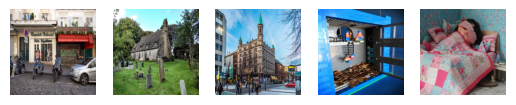

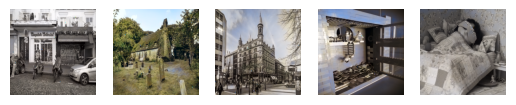


Saved model to ./ResnetBackbone_UNet_Full/UNet_2750.pth.
Train Epoch: 2751 [0/256 (0%)]	UNetLoss: 0.065093
Train Epoch: 2751 [160/256 (62%)]	UNetLoss: 0.077106
Train Epoch: 2752 [0/256 (0%)]	UNetLoss: 0.082021
Train Epoch: 2752 [160/256 (62%)]	UNetLoss: 0.074064
Train Epoch: 2753 [0/256 (0%)]	UNetLoss: 0.083088
Train Epoch: 2753 [160/256 (62%)]	UNetLoss: 0.091169
Train Epoch: 2754 [0/256 (0%)]	UNetLoss: 0.082760
Train Epoch: 2754 [160/256 (62%)]	UNetLoss: 0.096641
Train Epoch: 2755 [0/256 (0%)]	UNetLoss: 0.076674
Train Epoch: 2755 [160/256 (62%)]	UNetLoss: 0.086014
Train Epoch: 2756 [0/256 (0%)]	UNetLoss: 0.083031
Train Epoch: 2756 [160/256 (62%)]	UNetLoss: 0.095625
Train Epoch: 2757 [0/256 (0%)]	UNetLoss: 0.076680
Train Epoch: 2757 [160/256 (62%)]	UNetLoss: 0.083179
Train Epoch: 2758 [0/256 (0%)]	UNetLoss: 0.079345
Train Epoch: 2758 [160/256 (62%)]	UNetLoss: 0.063165
Train Epoch: 2759 [0/256 (0%)]	UNetLoss: 0.065582
Train Epoch: 2759 [160/256 (62%)]	UNetLoss: 0.072241
Train Epoch: 27

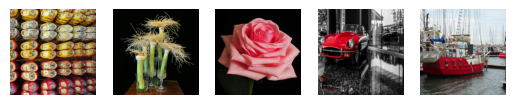

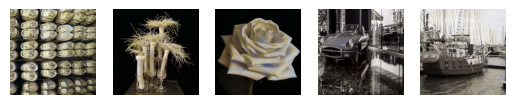

validation Output: 


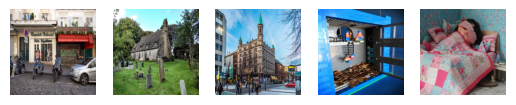

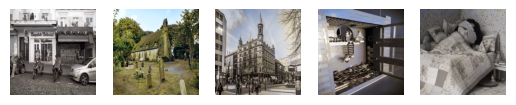


Saved model to ./ResnetBackbone_UNet_Full/UNet_2800.pth.
Train Epoch: 2801 [0/256 (0%)]	UNetLoss: 0.105996
Train Epoch: 2801 [160/256 (62%)]	UNetLoss: 0.100694
Train Epoch: 2802 [0/256 (0%)]	UNetLoss: 0.069522
Train Epoch: 2802 [160/256 (62%)]	UNetLoss: 0.065729
Train Epoch: 2803 [0/256 (0%)]	UNetLoss: 0.079101
Train Epoch: 2803 [160/256 (62%)]	UNetLoss: 0.075287
Train Epoch: 2804 [0/256 (0%)]	UNetLoss: 0.086919
Train Epoch: 2804 [160/256 (62%)]	UNetLoss: 0.101322
Train Epoch: 2805 [0/256 (0%)]	UNetLoss: 0.067633
Train Epoch: 2805 [160/256 (62%)]	UNetLoss: 0.098683
Train Epoch: 2806 [0/256 (0%)]	UNetLoss: 0.085539
Train Epoch: 2806 [160/256 (62%)]	UNetLoss: 0.080791
Train Epoch: 2807 [0/256 (0%)]	UNetLoss: 0.083882
Train Epoch: 2807 [160/256 (62%)]	UNetLoss: 0.081690
Train Epoch: 2808 [0/256 (0%)]	UNetLoss: 0.093734
Train Epoch: 2808 [160/256 (62%)]	UNetLoss: 0.083375
Train Epoch: 2809 [0/256 (0%)]	UNetLoss: 0.073063
Train Epoch: 2809 [160/256 (62%)]	UNetLoss: 0.082571
Train Epoch: 28

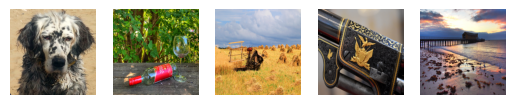

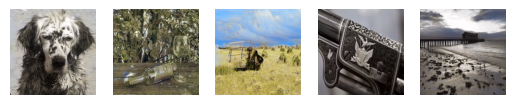

validation Output: 


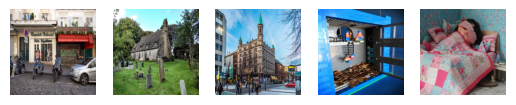

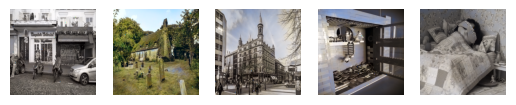


Saved model to ./ResnetBackbone_UNet_Full/UNet_2850.pth.
Train Epoch: 2851 [0/256 (0%)]	UNetLoss: 0.068918
Train Epoch: 2851 [160/256 (62%)]	UNetLoss: 0.072981
Train Epoch: 2852 [0/256 (0%)]	UNetLoss: 0.065572
Train Epoch: 2852 [160/256 (62%)]	UNetLoss: 0.095791
Train Epoch: 2853 [0/256 (0%)]	UNetLoss: 0.078674
Train Epoch: 2853 [160/256 (62%)]	UNetLoss: 0.073010
Train Epoch: 2854 [0/256 (0%)]	UNetLoss: 0.087002
Train Epoch: 2854 [160/256 (62%)]	UNetLoss: 0.067219
Train Epoch: 2855 [0/256 (0%)]	UNetLoss: 0.106503
Train Epoch: 2855 [160/256 (62%)]	UNetLoss: 0.070976
Train Epoch: 2856 [0/256 (0%)]	UNetLoss: 0.085106
Train Epoch: 2856 [160/256 (62%)]	UNetLoss: 0.083428
Train Epoch: 2857 [0/256 (0%)]	UNetLoss: 0.065729
Train Epoch: 2857 [160/256 (62%)]	UNetLoss: 0.098853
Train Epoch: 2858 [0/256 (0%)]	UNetLoss: 0.103028
Train Epoch: 2858 [160/256 (62%)]	UNetLoss: 0.064997
Train Epoch: 2859 [0/256 (0%)]	UNetLoss: 0.097246
Train Epoch: 2859 [160/256 (62%)]	UNetLoss: 0.075390
Train Epoch: 28

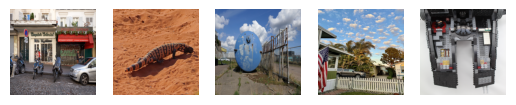

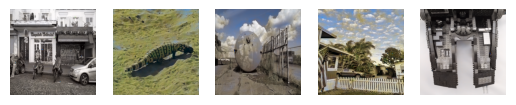

validation Output: 


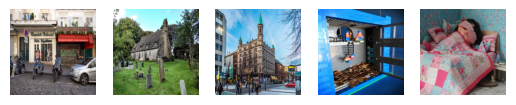

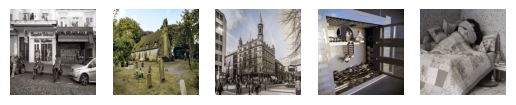


Saved model to ./ResnetBackbone_UNet_Full/UNet_2900.pth.
Train Epoch: 2901 [0/256 (0%)]	UNetLoss: 0.083245
Train Epoch: 2901 [160/256 (62%)]	UNetLoss: 0.075254
Train Epoch: 2902 [0/256 (0%)]	UNetLoss: 0.098964
Train Epoch: 2902 [160/256 (62%)]	UNetLoss: 0.057572
Train Epoch: 2903 [0/256 (0%)]	UNetLoss: 0.081334
Train Epoch: 2903 [160/256 (62%)]	UNetLoss: 0.093111
Train Epoch: 2904 [0/256 (0%)]	UNetLoss: 0.065495
Train Epoch: 2904 [160/256 (62%)]	UNetLoss: 0.077875
Train Epoch: 2905 [0/256 (0%)]	UNetLoss: 0.100479
Train Epoch: 2905 [160/256 (62%)]	UNetLoss: 0.100027
Train Epoch: 2906 [0/256 (0%)]	UNetLoss: 0.084623
Train Epoch: 2906 [160/256 (62%)]	UNetLoss: 0.084603
Train Epoch: 2907 [0/256 (0%)]	UNetLoss: 0.097918
Train Epoch: 2907 [160/256 (62%)]	UNetLoss: 0.078159
Train Epoch: 2908 [0/256 (0%)]	UNetLoss: 0.058120
Train Epoch: 2908 [160/256 (62%)]	UNetLoss: 0.089213
Train Epoch: 2909 [0/256 (0%)]	UNetLoss: 0.081882
Train Epoch: 2909 [160/256 (62%)]	UNetLoss: 0.103259
Train Epoch: 29

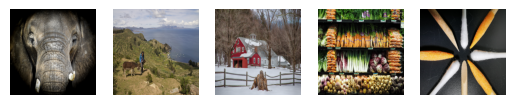

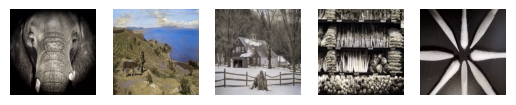

validation Output: 


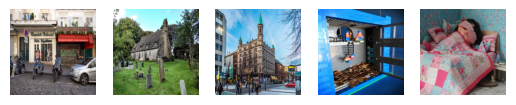

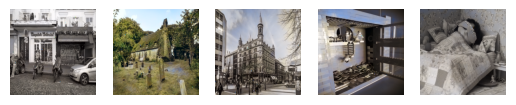


Saved model to ./ResnetBackbone_UNet_Full/UNet_2950.pth.
Train Epoch: 2951 [0/256 (0%)]	UNetLoss: 0.070346
Train Epoch: 2951 [160/256 (62%)]	UNetLoss: 0.067253
Train Epoch: 2952 [0/256 (0%)]	UNetLoss: 0.094020
Train Epoch: 2952 [160/256 (62%)]	UNetLoss: 0.106588
Train Epoch: 2953 [0/256 (0%)]	UNetLoss: 0.069956
Train Epoch: 2953 [160/256 (62%)]	UNetLoss: 0.080356
Train Epoch: 2954 [0/256 (0%)]	UNetLoss: 0.088045
Train Epoch: 2954 [160/256 (62%)]	UNetLoss: 0.095058
Train Epoch: 2955 [0/256 (0%)]	UNetLoss: 0.085404
Train Epoch: 2955 [160/256 (62%)]	UNetLoss: 0.090595
Train Epoch: 2956 [0/256 (0%)]	UNetLoss: 0.079489
Train Epoch: 2956 [160/256 (62%)]	UNetLoss: 0.059865
Train Epoch: 2957 [0/256 (0%)]	UNetLoss: 0.092269
Train Epoch: 2957 [160/256 (62%)]	UNetLoss: 0.077108
Train Epoch: 2958 [0/256 (0%)]	UNetLoss: 0.095844
Train Epoch: 2958 [160/256 (62%)]	UNetLoss: 0.082682
Train Epoch: 2959 [0/256 (0%)]	UNetLoss: 0.078538
Train Epoch: 2959 [160/256 (62%)]	UNetLoss: 0.085691
Train Epoch: 29

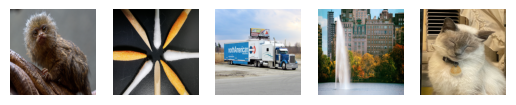

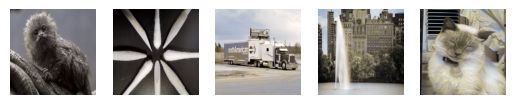

validation Output: 


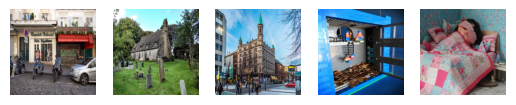

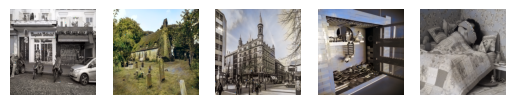


Saved model to ./ResnetBackbone_UNet_Full/UNet_3000.pth.
Train Epoch: 3001 [0/256 (0%)]	UNetLoss: 0.069280
Train Epoch: 3001 [160/256 (62%)]	UNetLoss: 0.078278
Train Epoch: 3002 [0/256 (0%)]	UNetLoss: 0.085849
Train Epoch: 3002 [160/256 (62%)]	UNetLoss: 0.078961


KeyboardInterrupt: 

In [ ]:
(loss_list, val_loss_list) = train_model(6000, model)

In [ ]:
saveModel(model, './ResnetBackbone_UNet_Full/UNet_6000.pth')

In [ ]:
torch.save(loss_list, './ResnetBackbone_UNet_Full/training_loss.pth')
torch.save(val_loss_list, './ResnetBackbone_UNet_Full/validation_loss.pth')

In [ ]:
model = UNet(ResidualBlock)
model.to(device)

model.load_state_dict(torch.load("./ResnetBackbone_UNet_Full/UNet_3000.pth", map_location='cuda:0'))

loss_list = np.array(torch.load('./ResnetBackbone_UNet_Full/training_loss.pth')) / 17

In [ ]:
for (X_batch, y_batch) in train_loader:
    img_X = X_batch
    img_y = y_batch
    break

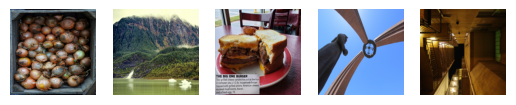

In [ ]:
imshow(img_X, img_y)

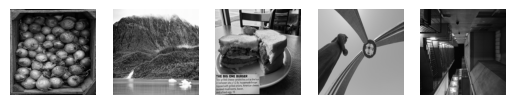

In [ ]:
imshow(img_X, torch.tensor(0.0).expand_as(img_y))

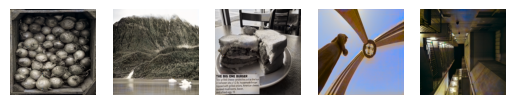

In [ ]:
imshow(img_X, model(img_X.to(device)).to('cpu'))        # Experiment 1 with relu and leakyrelu, and all residual blocks

In [ ]:
# Validation Output

In [ ]:
i= 0
c= 1
for (X_batch, y_batch) in val_loader:
    val_img_X = X_batch
    val_img_y = y_batch
    if(i == c):
        break;
    i+= 1

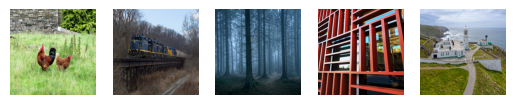

In [ ]:
imshow(val_img_X, val_img_y)

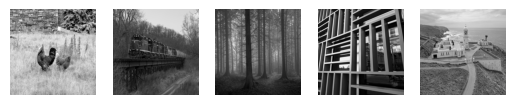

In [ ]:
imshow(val_img_X, torch.tensor(0.0).expand_as(val_img_y))

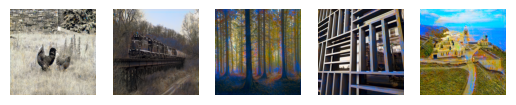

In [ ]:
imshow(val_img_X, model(val_img_X.to(device)).to('cpu'))

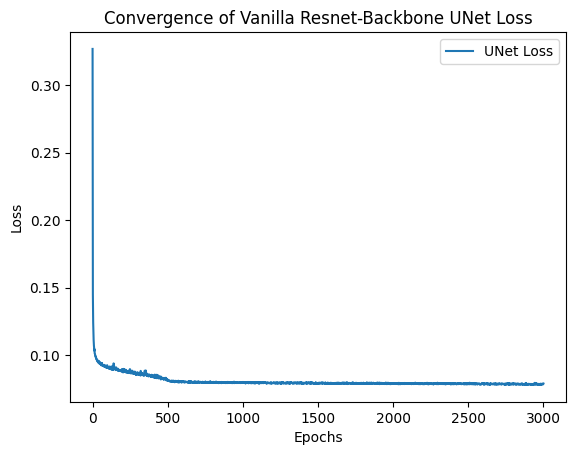

In [ ]:
# Plotting of unet loss with respect to number of epochs
plt.plot(loss_list, label='UNet Loss')
plt.legend()
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Convergence of Vanilla Resnet-Backbone UNet Loss")
plt.show()

In [ ]:
val_unet_loss = val_model(model, False)

In [ ]:
print("Validation set UNet Loss: ", val_unet_loss)

Validation set UNet Loss:  0.12328764574602247


In [ ]:
print("Training set UNet Loss: ", loss_list[-1])

Training set UNet Loss:  0.07891881860354368
